In [838]:
import pandas as pd
from sklearn.decomposition import NMF
from sklearn.preprocessing import StandardScaler, MinMaxScaler
import matplotlib.pyplot as plt
# PyTorch related imports would go here
import numpy as np

In [839]:
from sklearn.feature_extraction.text import TfidfVectorizer
from us import states
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import re

In [840]:
state_names = [state.name.lower() for state in states.STATES]
state_abbrs = [state.abbr for state in states.STATES]
city_df = pd.read_csv('PM25-Speciated/worldcities.csv')
city_names = city_df['city_ascii'].str.lower().tolist()  # First column
country_names = city_df['country'].str.lower().tolist()  # First column

In [841]:
stop_words = TfidfVectorizer(stop_words='english').get_stop_words()
stop_words = list(list(stop_words)+ city_names + country_names + state_names + state_abbrs)

# Original Data

In [842]:
# #DATASET_NAME = "SpeciateV5.3_PM_AE6.csv"
# DATASET_NAME = "SpeciateV5.3_PM_All.csv"
# df = pd.read_csv('PM25-Speciated/specviate_v5_3datasets/'+DATASET_NAME, encoding='ISO-8859-1')

In [843]:
# DATASET_NAME = "PM_AE6_v5.3_v10182024.csv"
# # DATASET_NAME = "PM_ALL2.5um_v5.3_v10182024.csv"
# df = pd.read_csv('PM25-Speciated/reviseddatasetwithtotalocandec/'+DATASET_NAME, encoding='ISO-8859-1')

In [844]:
SETTINGS_NO = "Case8"

### New dataset Feb 2025

In [845]:
# DATASET_NAME = "SPECIATE_V01282025_73_species.csv"
DATASET_NAME = "FinalDataset_transposed_02282025.csv"

df = pd.read_csv('PM25-Speciated/datasetasoffeb282025/'+DATASET_NAME, encoding='ISO-8859-1')

In [846]:
df

,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,2.5,Overall Composite,Miscellaneous,Miscellaneous,Miscellaneous,4.4430,0.0220,0.765,1.476,...,1.652,NaN,0.0140,5.5140,2.9720,0.117,0.1940,0.061,2.2330,0.0020
1,1,3190.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,5.9680,0.3476,0.000,0.000,...,NaN,NaN,0.1964,10.1716,2.9480,0.000,0.4315,0.000,0.0797,0.0247
2,2,3191.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,6.3904,0.3354,0.000,0.000,...,NaN,NaN,0.1373,2.1195,0.5934,0.000,0.4018,0.000,0.0857,0.0229
3,3,3192.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,5.5457,0.3598,0.000,0.000,...,NaN,NaN,0.2556,18.2238,5.3025,0.000,0.4612,0.000,0.0737,0.0266
4,4,3193.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,6.9752,0.3412,0.000,0.000,...,NaN,NaN,0.2784,7.5760,2.2323,0.000,0.4532,0.000,0.0653,0.0261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,1341,900122.5,Clay And Fly Ash Sintering - Average,Ash,Industrial; Metal; Sintering,Miscellaneous,0.4650,NaN,NaN,NaN,...,0.520,NaN,NaN,9.6000,3.2000,NaN,0.0070,0.004,0.0090,NaN
1342,1342,900132.5,Mineral Products - Average,Dust,Mineral Products,Miscellaneous,2.1110,NaN,0.021,0.008,...,1.466,NaN,0.0120,14.0610,5.1430,0.004,0.1340,0.004,0.1270,0.0010
1343,1343,900142.5,Petroleum Industry - Average,Volatilization,Petrochemical,Miscellaneous,2.4840,NaN,0.001,NaN,...,NaN,NaN,0.0280,23.5000,10.0560,0.001,0.0590,NaN,0.2780,0.0250
1344,1344,900152.5,Pulp And Paper Industry,Combustion,Pulp And Paper,Miscellaneous,0.0900,NaN,0.004,0.001,...,10.775,NaN,0.0070,20.3960,5.6700,0.008,0.0030,0.009,0.0170,0.0030


In [847]:
# df = df.pivot_table(index=['PROFILE_CODE', 'PROFILE_NAME'], columns='SPECIES_NAME', values='WEIGHT_PERCENT', aggfunc='first').reset_index()
# # Fill NaN values with 0 (or any other value you prefer)
# df = df.fillna(0)

In [848]:
unique_scc1_values = df['SCC2'].unique()
unique_scc1_values

array(['Miscellaneous', 'Electric Generation; Boiler', 'Boiler',
       'Agriculture', 'Road', 'Mobile; Onroad',
       'Petrochemical; Catalytic Cracker',
       'Biomass Burning; Residential Wood Combustion; Fireplace',
       'Biomass Burning; Residential Wood Combustion; Woodstove',
       'Biomass Burning; Agriculture', 'Electric Generation; Incinerator',
       'Waste', 'Geological', 'Desert', 'Volcanic', 'Construction',
       'Non-industrial', 'Industrial', 'Windblown', 'Geothermal',
       'Regional', 'Residential Heating', 'Biomass Burning; Wildfire',
       'Biomass Burning; Residential Wood Combustion; Fireplace; Woodstove',
       'Mobile; Onroad; Heavy Duty', 'Mobile; Onroad; Light Duty',
       'Cooking; Charbroiling', 'Petrochemical', 'Waste Combustion',
       'Industrial; Boiler', 'Mineral Products; Kiln',
       'Cooking; Stirfrying', 'Cooking; Charbroiling; Stirfry; Smoke',
       'Petrochemical; Process Heater', 'Turbine', 'Process Heater',
       'Biomass Burning;

In [849]:
def clean_text(text):
    # Remove numbers and special characters
    text = re.sub(r'[^A-Za-z\s]', ' ', text)
    # Convert to lowercase
    text = text.lower()
    # Remove stopwords
    text = ' '.join(word for word in text.split() if word not in stop_words)
    return text

In [850]:
# df['name'] = df['name'].apply(clean_text)

In [851]:
df

,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,2.5,Overall Composite,Miscellaneous,Miscellaneous,Miscellaneous,4.4430,0.0220,0.765,1.476,...,1.652,NaN,0.0140,5.5140,2.9720,0.117,0.1940,0.061,2.2330,0.0020
1,1,3190.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,5.9680,0.3476,0.000,0.000,...,NaN,NaN,0.1964,10.1716,2.9480,0.000,0.4315,0.000,0.0797,0.0247
2,2,3191.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,6.3904,0.3354,0.000,0.000,...,NaN,NaN,0.1373,2.1195,0.5934,0.000,0.4018,0.000,0.0857,0.0229
3,3,3192.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,5.5457,0.3598,0.000,0.000,...,NaN,NaN,0.2556,18.2238,5.3025,0.000,0.4612,0.000,0.0737,0.0266
4,4,3193.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,6.9752,0.3412,0.000,0.000,...,NaN,NaN,0.2784,7.5760,2.2323,0.000,0.4532,0.000,0.0653,0.0261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,1341,900122.5,Clay And Fly Ash Sintering - Average,Ash,Industrial; Metal; Sintering,Miscellaneous,0.4650,NaN,NaN,NaN,...,0.520,NaN,NaN,9.6000,3.2000,NaN,0.0070,0.004,0.0090,NaN
1342,1342,900132.5,Mineral Products - Average,Dust,Mineral Products,Miscellaneous,2.1110,NaN,0.021,0.008,...,1.466,NaN,0.0120,14.0610,5.1430,0.004,0.1340,0.004,0.1270,0.0010
1343,1343,900142.5,Petroleum Industry - Average,Volatilization,Petrochemical,Miscellaneous,2.4840,NaN,0.001,NaN,...,NaN,NaN,0.0280,23.5000,10.0560,0.001,0.0590,NaN,0.2780,0.0250
1344,1344,900152.5,Pulp And Paper Industry,Combustion,Pulp And Paper,Miscellaneous,0.0900,NaN,0.004,0.001,...,10.775,NaN,0.0070,20.3960,5.6700,0.008,0.0030,0.009,0.0170,0.0030


In [852]:
# numeric_cols = df.select_dtypes(include=[np.number]).columns
# text_cols = df.select_dtypes(include=[object]).columns

# print(text_cols)

# agg_funcs = {col: 'mean' for col in numeric_cols}
# agg_funcs.update({col: lambda x: np.random.choice(x) for col in text_cols if col != 'name'})

# pivot_df = df.groupby('name').agg(agg_funcs).reset_index()

In [853]:
# cols = list(pivot_df.columns)
# cols.insert(0, cols.pop(cols.index('code')))
# pivot_df = pivot_df[cols]
# pivot_df

In [854]:
pivot_df = df
pivot_df

,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,2.5,Overall Composite,Miscellaneous,Miscellaneous,Miscellaneous,4.4430,0.0220,0.765,1.476,...,1.652,NaN,0.0140,5.5140,2.9720,0.117,0.1940,0.061,2.2330,0.0020
1,1,3190.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,5.9680,0.3476,0.000,0.000,...,NaN,NaN,0.1964,10.1716,2.9480,0.000,0.4315,0.000,0.0797,0.0247
2,2,3191.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,6.3904,0.3354,0.000,0.000,...,NaN,NaN,0.1373,2.1195,0.5934,0.000,0.4018,0.000,0.0857,0.0229
3,3,3192.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,5.5457,0.3598,0.000,0.000,...,NaN,NaN,0.2556,18.2238,5.3025,0.000,0.4612,0.000,0.0737,0.0266
4,4,3193.0,Coal Combustion,Combustion,Electric Generation; Boiler,Coal,6.9752,0.3412,0.000,0.000,...,NaN,NaN,0.2784,7.5760,2.2323,0.000,0.4532,0.000,0.0653,0.0261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,1341,900122.5,Clay And Fly Ash Sintering - Average,Ash,Industrial; Metal; Sintering,Miscellaneous,0.4650,NaN,NaN,NaN,...,0.520,NaN,NaN,9.6000,3.2000,NaN,0.0070,0.004,0.0090,NaN
1342,1342,900132.5,Mineral Products - Average,Dust,Mineral Products,Miscellaneous,2.1110,NaN,0.021,0.008,...,1.466,NaN,0.0120,14.0610,5.1430,0.004,0.1340,0.004,0.1270,0.0010
1343,1343,900142.5,Petroleum Industry - Average,Volatilization,Petrochemical,Miscellaneous,2.4840,NaN,0.001,NaN,...,NaN,NaN,0.0280,23.5000,10.0560,0.001,0.0590,NaN,0.2780,0.0250
1344,1344,900152.5,Pulp And Paper Industry,Combustion,Pulp And Paper,Miscellaneous,0.0900,NaN,0.004,0.001,...,10.775,NaN,0.0070,20.3960,5.6700,0.008,0.0030,0.009,0.0170,0.0030


In [855]:
pivot_df['SCC1'] = pd.factorize(pivot_df['SCC1'])[0]
pivot_df['SCC3'] = pd.factorize(pivot_df['SCC3'])[0]

In [856]:
# Step 2: Ensure SCC2 is treated as a string column
pivot_df['SCC2'] = pivot_df['SCC2'].astype(str)

# Split SCC2 based on ;
split_SCC2 = pivot_df['SCC2'].str.split(';', expand=True)

# Get unique sentence fragments
unique_fragments = pd.unique(split_SCC2.values.ravel('K'))

print(unique_fragments)

# Remove None values (if any)
unique_fragments = [fragment for fragment in unique_fragments if pd.notna(fragment) and fragment != 'nan']

# Create one-hot encoding for each fragment
one_hot_encoded = pd.DataFrame(0, index=pivot_df.index, columns=unique_fragments)

print(one_hot_encoded)

for col in split_SCC2.columns:
    for idx, fragment in split_SCC2[col].items():
        if pd.notna(fragment) and fragment != 'nan':
            one_hot_encoded.at[idx, fragment] = 1

# Step 3: Convert each row of one-hot encoding into a tuple
one_hot_tuples = [tuple(row) for row in one_hot_encoded.values]

# Step 4: Assign a unique sequential number to each unique combination
unique_combinations = pd.factorize(one_hot_tuples)[0]

# Add the sequential numbers to the DataFrame
pivot_df['SCC2'] = unique_combinations

# Display the transformed DataFrame
print(pivot_df)

['Miscellaneous' 'Electric Generation' 'Boiler' 'Agriculture' 'Road'
 'Mobile' 'Petrochemical' 'Biomass Burning' 'Waste' 'Geological' 'Desert'
 'Volcanic' 'Construction' 'Non-industrial' 'Industrial' 'Windblown'
 'Geothermal' 'Regional' 'Residential Heating' 'Cooking'
 'Waste Combustion' 'Mineral Products' 'Turbine' 'Process Heater'
 'Cigarette' 'Surface Coating' 'Pulp And Paper' 'Residential'
 'Stationary Engine' 'Furnace' 'Domestic' 'Chemical Manufacturing'
 'Combustion' 'Refinery' 'Incinerator' 'Secondary Aluminum Furnace'
 'Melting Pot' 'Smelting' 'Crop Heating' 'Food And Agriculture' None
 ' Boiler' ' Onroad' ' Catalytic Cracker' ' Residential Wood Combustion'
 ' Agriculture' ' Incinerator' ' Wildfire' ' Charbroiling' ' Kiln'
 ' Stirfrying' ' Process Heater' ' Frying' ' Spraying' ' Marine'
 ' Furnace' ' Aircraft' ' Metal' ' Silo' ' Gas Turbine' ' Prescribed Fire'
 ' Metal And Construction' ' Wood Products' ' Shredding' ' Mining'
 ' Calciner' ' Space Heater And Water Heater' ' Spac

In [857]:
pivot_df.iloc[:,3:]

,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,Barium,Cadmium,Calcium,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,0,0,4.4430,0.0220,0.765,1.476,0.0520,0.421,2.6140,...,1.652,NaN,0.0140,5.5140,2.9720,0.117,0.1940,0.061,2.2330,0.0020
1,1,1,1,5.9680,0.3476,0.000,0.000,1.3315,0.000,3.4536,...,NaN,NaN,0.1964,10.1716,2.9480,0.000,0.4315,0.000,0.0797,0.0247
2,1,1,1,6.3904,0.3354,0.000,0.000,0.3697,0.000,2.5607,...,NaN,NaN,0.1373,2.1195,0.5934,0.000,0.4018,0.000,0.0857,0.0229
3,1,1,1,5.5457,0.3598,0.000,0.000,2.2933,0.000,4.3464,...,NaN,NaN,0.2556,18.2238,5.3025,0.000,0.4612,0.000,0.0737,0.0266
4,1,1,1,6.9752,0.3412,0.000,0.000,1.2348,0.000,4.6981,...,NaN,NaN,0.2784,7.5760,2.2323,0.000,0.4532,0.000,0.0653,0.0261
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,5,81,0,0.4650,NaN,NaN,NaN,NaN,NaN,15.0700,...,0.520,NaN,NaN,9.6000,3.2000,NaN,0.0070,0.004,0.0090,NaN
1342,2,50,0,2.1110,NaN,0.021,0.008,0.0610,0.015,9.8600,...,1.466,NaN,0.0120,14.0610,5.1430,0.004,0.1340,0.004,0.1270,0.0010
1343,7,27,0,2.4840,NaN,0.001,NaN,0.0000,0.000,2.5180,...,NaN,NaN,0.0280,23.5000,10.0560,0.001,0.0590,NaN,0.2780,0.0250
1344,1,47,0,0.0900,NaN,0.004,0.001,0.0160,0.003,0.4240,...,10.775,NaN,0.0070,20.3960,5.6700,0.008,0.0030,0.009,0.0170,0.0030


## Handling missing attribute

In [858]:
## link of different imputer
# https://scikit-learn.org/stable/modules/generated/sklearn.impute.SimpleImputer.html

In [859]:
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer, SimpleImputer, KNNImputer

print(pivot_df.columns[3:])

# imputer = IterativeImputer()
imputer = SimpleImputer(strategy='mean')
# imputer = KNNImputer()
df_imputed = pd.DataFrame(imputer.fit_transform(pivot_df.iloc[:,3:]), columns=df.columns[3:])
pivot_df[pivot_df.columns[3:]]=df_imputed
pivot_df

Index(['SCC1', 'SCC2', 'SCC3', 'Aluminum', 'Ammonium', 'Antimony', 'Arsenic',
       'Barium', 'Cadmium', 'Calcium', 'Chloride ion', 'Chromium', 'Cobalt',
       'Copper', 'Elemental Carbon', 'Indium', 'Iron', 'Lead', 'Magnesium',
       'Manganese', 'Mercury', 'Molybdenum', 'Nickel', 'Nitrate',
       'Organic carbon', 'Phosphorus', 'Potassium', 'Potassium ion',
       'Selenium', 'Silicon', 'Silver', 'Sodium', 'Sodium ion', 'Strontium',
       'Sulfate', 'Sulfur', 'Tin', 'Titanium', 'Vanadium', 'Zinc',
       'Zirconium'],
      dtype='object')


,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,2.5,Overall Composite,0.0,0.0,0.0,4.4430,0.022000,0.765000,1.476000,...,1.652000,0.826108,0.014000,5.5140,2.9720,0.117000,0.1940,0.061000,2.2330,0.002000
1,1,3190.0,Coal Combustion,1.0,1.0,1.0,5.9680,0.347600,0.000000,0.000000,...,1.422516,0.826108,0.196400,10.1716,2.9480,0.000000,0.4315,0.000000,0.0797,0.024700
2,2,3191.0,Coal Combustion,1.0,1.0,1.0,6.3904,0.335400,0.000000,0.000000,...,1.422516,0.826108,0.137300,2.1195,0.5934,0.000000,0.4018,0.000000,0.0857,0.022900
3,3,3192.0,Coal Combustion,1.0,1.0,1.0,5.5457,0.359800,0.000000,0.000000,...,1.422516,0.826108,0.255600,18.2238,5.3025,0.000000,0.4612,0.000000,0.0737,0.026600
4,4,3193.0,Coal Combustion,1.0,1.0,1.0,6.9752,0.341200,0.000000,0.000000,...,1.422516,0.826108,0.278400,7.5760,2.2323,0.000000,0.4532,0.000000,0.0653,0.026100
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1341,1341,900122.5,Clay And Fly Ash Sintering - Average,5.0,81.0,0.0,0.4650,1.317309,0.271583,0.569665,...,0.520000,0.826108,0.045702,9.6000,3.2000,0.051516,0.0070,0.004000,0.0090,0.009459
1342,1342,900132.5,Mineral Products - Average,2.0,50.0,0.0,2.1110,1.317309,0.021000,0.008000,...,1.466000,0.826108,0.012000,14.0610,5.1430,0.004000,0.1340,0.004000,0.1270,0.001000
1343,1343,900142.5,Petroleum Industry - Average,7.0,27.0,0.0,2.4840,1.317309,0.001000,0.569665,...,1.422516,0.826108,0.028000,23.5000,10.0560,0.001000,0.0590,0.087979,0.2780,0.025000
1344,1344,900152.5,Pulp And Paper Industry,1.0,47.0,0.0,0.0900,1.317309,0.004000,0.001000,...,10.775000,0.826108,0.007000,20.3960,5.6700,0.008000,0.0030,0.009000,0.0170,0.003000


# Clustering based on numeric values

In [860]:
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from collections import Counter

In [861]:
def assign_cluster_name(cluster):
    names = pivot_df[pivot_df['speciated_cluster'] == cluster]['PROFILE_NAME']
    most_common_name = Counter(names).most_common(1)[0][0]
    return most_common_name

In [862]:
X = pivot_df.iloc[:, 3:]
# scaler = StandardScaler()
scaler = MinMaxScaler()
X = scaler.fit_transform(X)

In [863]:
X

array([[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
        4.75781920e-03, 2.79125000e-02, 3.63636364e-03],
       [1.42857143e-01, 1.09890110e-02, 5.34759358e-03, ...,
        0.00000000e+00, 9.96250000e-04, 4.49090909e-02],
       [1.42857143e-01, 1.09890110e-02, 5.34759358e-03, ...,
        0.00000000e+00, 1.07125000e-03, 4.16363636e-02],
       ...,
       [1.00000000e+00, 2.96703297e-01, 0.00000000e+00, ...,
        6.86211541e-03, 3.47500000e-03, 4.54545455e-02],
       [1.42857143e-01, 5.16483516e-01, 0.00000000e+00, ...,
        7.01973325e-04, 2.12500000e-04, 5.45454545e-03],
       [2.85714286e-01, 1.86813187e-01, 0.00000000e+00, ...,
        2.96388737e-03, 4.14875000e-02, 3.63636364e-03]])

In [864]:
# model = NMF(n_components=32, init='random', random_state=0, max_iter=1000)
# W = model.fit_transform(X)
# H = model.components_

# What features to use for clustering

In [865]:
# Assuming 'target' is the category column, and 'name' is the label
X = pivot_df.iloc[:, 3:]
#X = W

# Hierarchical Clustering

## k-NN Graph Construction

In [866]:
from sklearn.neighbors import NearestNeighbors
import networkx as nx
from scipy.sparse.linalg import svds

In [867]:
# Apply SVD to X
U, S, VT = svds(X.values, k=16)
X_svd = U @ np.diag(S) @ VT

In [868]:
X = X_svd

In [869]:
# Compute KNN

K = 5
knn = NearestNeighbors(n_neighbors=K)  # You can change the number of neighbors
knn.fit(X)
distances, indices = knn.kneighbors(X)

# Create a graph
G = nx.Graph()

# Add nodes with PROFILE_NAME as labels
for i, profile_name in enumerate(df['PROFILE_NAME']):
    G.add_node(i, label=profile_name)

# Add edges based on KNN
for i, neighbors in enumerate(indices):
    for neighbor in neighbors:
        if i != neighbor:  # Avoid self-loops
            G.add_edge(i, neighbor)

In [870]:
import matplotlib
matplotlib.use('Agg')  # Use a non-interactive backend

In [871]:
# pos = nx.spring_layout(G)  # Layout for visualization
# labels = nx.get_node_attributes(G, 'label')

# plt.figure(figsize=(50, 50))
# nx.draw(G, pos, with_labels=True, labels=labels, node_size=100, node_color='skyblue', font_size=10, font_color='black', edge_color='gray')
# plt.title('K-Nearest Neighbor Graph')
# plt.show()

# Community Dectection

In [872]:
import cdlib
from cdlib import algorithms
import networkx as nx
# G = nx.karate_club_graph()

# non-overlap louvain
coms = algorithms.louvain(G, weight='weight', resolution=1., randomize=False)

In [873]:
print(coms.method_name)
print(coms.communities)
print(coms.node_coverage)
print(coms.overlap )
print(coms.method_parameters)
#print(coms.to_json)
print(coms.average_internal_degree())
print(coms.average_internal_degree(summary=False))

Louvain
[[68, 236, 237, 238, 240, 296, 297, 298, 299, 331, 333, 337, 347, 348, 349, 350, 541, 575, 643, 644, 645, 648, 649, 650, 652, 656, 659, 660, 663, 667, 670, 671, 673, 676, 677, 678, 688, 726, 727, 729, 731, 732, 733, 734, 736, 739, 740, 743, 745, 747, 748, 749, 750, 751, 754, 755, 756, 757, 758, 759, 760, 761, 762, 763, 764, 765, 766, 767, 768, 770, 771, 772, 773, 774, 775, 788, 819, 1163, 1164, 1166, 1167, 1169, 1170, 1308, 1344], [5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 42, 74, 75, 76, 77, 78, 79, 80, 81, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 98, 99, 100, 101, 102, 108, 109, 110, 111, 112, 113, 124, 125, 127, 128, 129, 130, 131, 132, 133, 142, 145, 146, 147, 189, 198, 199, 200, 201, 206, 207, 208, 209, 211, 325, 326, 327, 328, 330, 354, 357, 368, 373, 804, 825, 845, 969, 970, 1203, 1204, 1221, 1229, 1231, 1233], [213, 239, 241, 243, 332, 334, 335, 336, 338, 339, 340, 341, 342, 343, 344, 345, 346, 505, 537, 561, 562, 572, 642, 646, 647, 651, 653, 654, 655, 657, 658, 661, 662,

In [874]:
com_map={}

for i in range(len(coms.communities)):
    community = coms.communities[i]
    for j in community:
        com_map[j] = i
        
com_map

{68: 0,
 236: 0,
 237: 0,
 238: 0,
 240: 0,
 296: 0,
 297: 0,
 298: 0,
 299: 0,
 331: 0,
 333: 0,
 337: 0,
 347: 0,
 348: 0,
 349: 0,
 350: 0,
 541: 0,
 575: 0,
 643: 0,
 644: 0,
 645: 0,
 648: 0,
 649: 0,
 650: 0,
 652: 0,
 656: 0,
 659: 0,
 660: 0,
 663: 0,
 667: 0,
 670: 0,
 671: 0,
 673: 0,
 676: 0,
 677: 0,
 678: 0,
 688: 0,
 726: 0,
 727: 0,
 729: 0,
 731: 0,
 732: 0,
 733: 0,
 734: 0,
 736: 0,
 739: 0,
 740: 0,
 743: 0,
 745: 0,
 747: 0,
 748: 0,
 749: 0,
 750: 0,
 751: 0,
 754: 0,
 755: 0,
 756: 0,
 757: 0,
 758: 0,
 759: 0,
 760: 0,
 761: 0,
 762: 0,
 763: 0,
 764: 0,
 765: 0,
 766: 0,
 767: 0,
 768: 0,
 770: 0,
 771: 0,
 772: 0,
 773: 0,
 774: 0,
 775: 0,
 788: 0,
 819: 0,
 1163: 0,
 1164: 0,
 1166: 0,
 1167: 0,
 1169: 0,
 1170: 0,
 1308: 0,
 1344: 0,
 5: 1,
 7: 1,
 8: 1,
 9: 1,
 10: 1,
 11: 1,
 12: 1,
 13: 1,
 14: 1,
 15: 1,
 42: 1,
 74: 1,
 75: 1,
 76: 1,
 77: 1,
 78: 1,
 79: 1,
 80: 1,
 81: 1,
 85: 1,
 86: 1,
 87: 1,
 88: 1,
 89: 1,
 90: 1,
 91: 1,
 92: 1,
 93: 1,
 94: 1,


In [875]:
coms_l = [algorithms.louvain(G), algorithms.label_propagation(G), algorithms.walktrap(G)]
overlap_coms = algorithms.endntm(G, coms_l)

In [876]:
print(overlap_coms.communities)

[[5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 804, 42, 825, 325, 326, 327, 328, 74, 75, 76, 77, 78, 79, 80, 81, 330, 845, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 98, 99, 100, 101, 102, 354, 357, 108, 109, 110, 111, 112, 113, 368, 373, 124, 125, 127, 128, 129, 130, 131, 132, 133, 142, 145, 146, 147, 1203, 1204, 189, 1221, 198, 199, 200, 201, 969, 970, 1229, 206, 207, 208, 209, 1231, 211, 1233], [769, 1027, 1283, 1290, 1291, 537, 1306, 1308, 1313, 1316, 561, 562, 823, 824, 572, 828, 830, 833, 834, 835, 840, 332, 334, 335, 336, 846, 338, 339, 340, 341, 342, 343, 344, 345, 346, 642, 1155, 1157, 646, 647, 1158, 1159, 651, 653, 654, 655, 1165, 657, 658, 661, 662, 664, 665, 666, 668, 669, 672, 674, 680, 681, 682, 683, 684, 685, 686, 687, 689, 213, 728, 730, 737, 738, 741, 744, 746, 239, 752, 241, 753, 243, 505], [1028, 1032, 1033, 1034, 1035, 1036, 1037, 1038, 1042, 1043, 1044, 1045, 1315, 1317, 811, 1324, 1070, 1071, 1072, 1073, 1074, 1075, 1076, 1328, 1078, 1329, 1080, 1081, 1082, 1083, 1334, 1

In [877]:
overlap_com_map={}

for i in range(len(overlap_coms.communities)):
    community = overlap_coms.communities[i]
    for j in community:
        if j in overlap_com_map:
            overlap_com_map[j].append(i)
        else:
            overlap_com_map[j] = [i]
            
overlap_com_map

{5: [0],
 7: [0],
 8: [0],
 9: [0],
 10: [0],
 11: [0],
 12: [0],
 13: [0],
 14: [0],
 15: [0],
 804: [0],
 42: [0],
 825: [0],
 325: [0],
 326: [0],
 327: [0],
 328: [0],
 74: [0],
 75: [0],
 76: [0],
 77: [0],
 78: [0],
 79: [0],
 80: [0],
 81: [0],
 330: [0],
 845: [0],
 85: [0],
 86: [0],
 87: [0],
 88: [0],
 89: [0],
 90: [0],
 91: [0],
 92: [0],
 93: [0],
 94: [0],
 95: [0],
 98: [0],
 99: [0],
 100: [0],
 101: [0],
 102: [0],
 354: [0],
 357: [0],
 108: [0],
 109: [0],
 110: [0],
 111: [0],
 112: [0],
 113: [0],
 368: [0],
 373: [0],
 124: [0],
 125: [0],
 127: [0],
 128: [0],
 129: [0],
 130: [0],
 131: [0],
 132: [0],
 133: [0],
 142: [0],
 145: [0],
 146: [0],
 147: [0],
 1203: [0],
 1204: [0],
 189: [0],
 1221: [0],
 198: [0],
 199: [0],
 200: [0],
 201: [0],
 969: [0],
 970: [0],
 1229: [0],
 206: [0],
 207: [0],
 208: [0],
 209: [0],
 1231: [0],
 211: [0],
 1233: [0],
 769: [1],
 1027: [1],
 1283: [1],
 1290: [1],
 1291: [1],
 537: [1],
 1306: [1],
 1308: [1],
 1313: [1],


In [878]:
for i in range(len(pivot_df)):
    if i not in overlap_com_map:
        print(i)

In [879]:
# nx.write_graphml(G, 'knn_graph.graphml')


labels=[]
# y = [i+'-'+j for i,j in zip(pivot_df['PROFILE_NAME'],pivot_df['PROFILE_CODE'])]
y = [str(i) for i in pivot_df['PROFILE_CODE']]
labels = dict(zip(range(len(y)), y))

print(labels)

overlap_com_map_str = {key: ",".join([str(i) for i in value]) for key, value in overlap_com_map.items()}

nx.set_node_attributes(G, labels, 'labels')
nx.set_node_attributes(G, com_map, 'non_overlap_community')
nx.set_node_attributes(G, overlap_com_map_str, 'overlap_community')

filename = SETTINGS_NO+DATASET_NAME+"KNN"+str(K)+'.gexf'
print("Writing gephi...."+filename)
nx.write_gexf(G, filename)
print("Done....")

{0: '2.5', 1: '3190.0', 2: '3191.0', 3: '3192.0', 4: '3193.0', 5: '3194.0', 6: '3195.0', 7: '3196.0', 8: '3197.0', 9: '3198.0', 10: '3199.0', 11: '3200.0', 12: '3201.0', 13: '3202.0', 14: '3203.0', 15: '3204.0', 16: '3205.0', 17: '3206.0', 18: '3207.0', 19: '3208.0', 20: '3209.0', 21: '3210.0', 22: '3211.0', 23: '3212.0', 24: '3213.0', 25: '3214.0', 26: '3215.0', 27: '3216.0', 28: '3217.0', 29: '3218.0', 30: '3219.0', 31: '3220.0', 32: '3221.0', 33: '3222.0', 34: '3223.0', 35: '3224.0', 36: '3225.0', 37: '3226.0', 38: '3227.0', 39: '3228.0', 40: '3229.0', 41: '3230.0', 42: '3231.0', 43: '3232.0', 44: '3233.0', 45: '3234.0', 46: '3235.0', 47: '3236.0', 48: '3237.0', 49: '3238.0', 50: '3239.0', 51: '3240.0', 52: '3241.0', 53: '3243.0', 54: '3246.0', 55: '3248.0', 56: '3251.0', 57: '3253.0', 58: '3256.0', 59: '3258.0', 60: '3261.0', 61: '3263.0', 62: '3266.0', 63: '3268.0', 64: '3271.0', 65: '3273.0', 66: '3276.0', 67: '3278.0', 68: '3281.0', 69: '3283.0', 70: '3286.0', 71: '3288.0', 72: 

Done....


In [880]:
pivot_df.head()

,Unnamed: 0,PROFILE_CODE,PROFILE_NAME,SCC1,SCC2,SCC3,Aluminum,Ammonium,Antimony,Arsenic,...,Sodium,Sodium ion,Strontium,Sulfate,Sulfur,Tin,Titanium,Vanadium,Zinc,Zirconium
0,0,2.5,Overall Composite,0.0,0.0,0.0,4.4430,0.0220,0.765,1.476,...,1.652000,0.826108,0.0140,5.5140,2.9720,0.117,0.1940,0.061,2.2330,0.0020
1,1,3190.0,Coal Combustion,1.0,1.0,1.0,5.9680,0.3476,0.000,0.000,...,1.422516,0.826108,0.1964,10.1716,2.9480,0.000,0.4315,0.000,0.0797,0.0247
2,2,3191.0,Coal Combustion,1.0,1.0,1.0,6.3904,0.3354,0.000,0.000,...,1.422516,0.826108,0.1373,2.1195,0.5934,0.000,0.4018,0.000,0.0857,0.0229
3,3,3192.0,Coal Combustion,1.0,1.0,1.0,5.5457,0.3598,0.000,0.000,...,1.422516,0.826108,0.2556,18.2238,5.3025,0.000,0.4612,0.000,0.0737,0.0266
4,4,3193.0,Coal Combustion,1.0,1.0,1.0,6.9752,0.3412,0.000,0.000,...,1.422516,0.826108,0.2784,7.5760,2.2323,0.000,0.4532,0.000,0.0653,0.0261


In [881]:
pivot_df.to_csv("ForSOM_"+DATASET_NAME, index=False)
print("DataFrame saved")

DataFrame saved


# Save CSVs

In [882]:
data = {
    'Row Number': list(range(len(pivot_df))),
    'PROFILE_CODE': pivot_df['PROFILE_CODE'],
    'PROFILE_NAME': pivot_df['PROFILE_NAME'],
    'Community Number': [com_map[row] for row in range(len(pivot_df))],
    'Overlapping Community': [overlap_com_map_str[row] for row in range(len(pivot_df))]
}

result_df = pd.DataFrame(data)

# Save the DataFrame to a CSV file
file_name = DATASET_NAME+"_KNN"+str(K)+'_community_info.csv'
result_df.to_csv(file_name, index=False)
print("Saved in ",file_name)

Saved in  FinalDataset_transposed_02282025.csv_KNN5_community_info.csv


# All cluster box plot

In [883]:
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable

# This magic command ensures that plots are shown inline in Jupyter Notebook
%matplotlib inline

In [884]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import TruncatedSVD, NMF

In [885]:
cluster_number = len(coms.communities)
print(cluster_number)

30


### All species

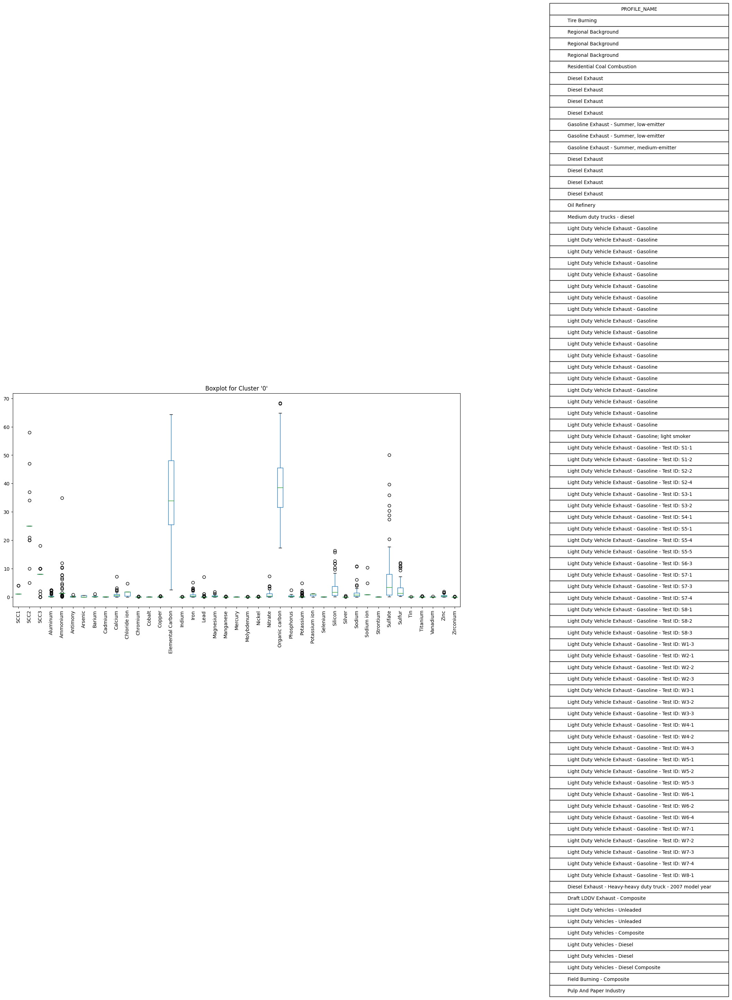

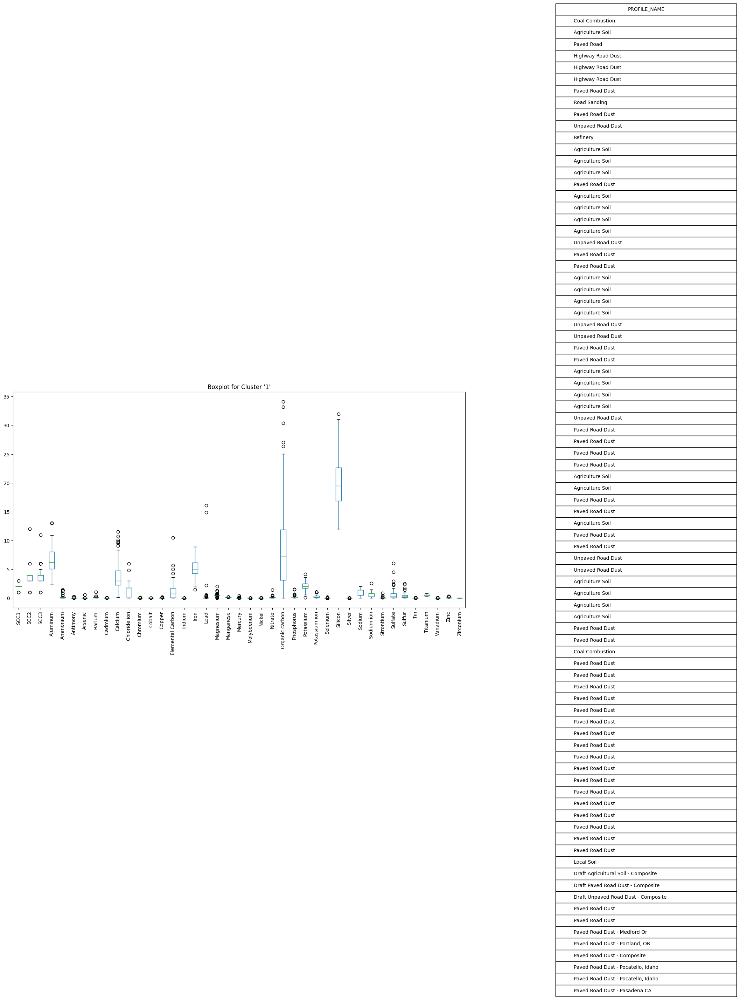

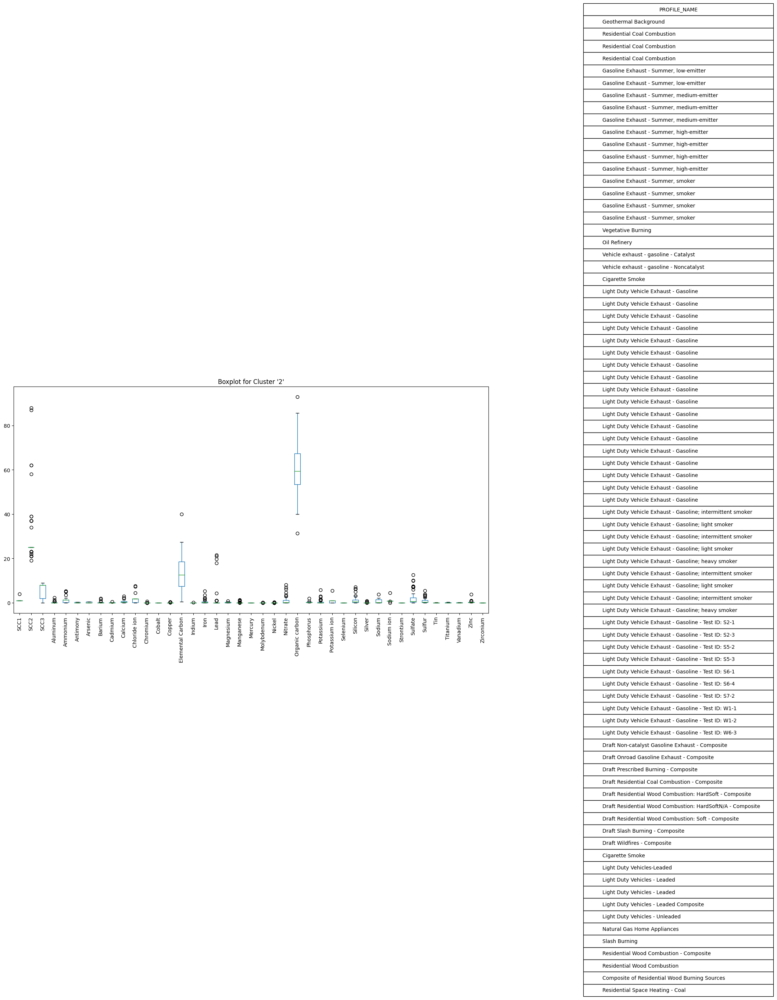

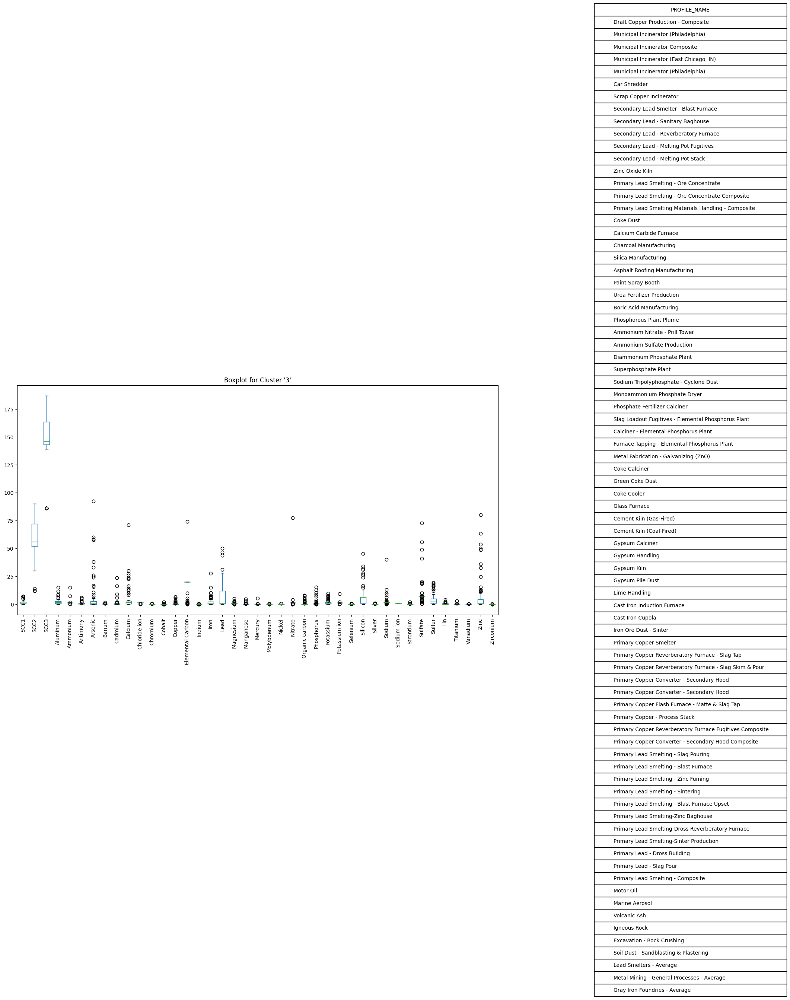

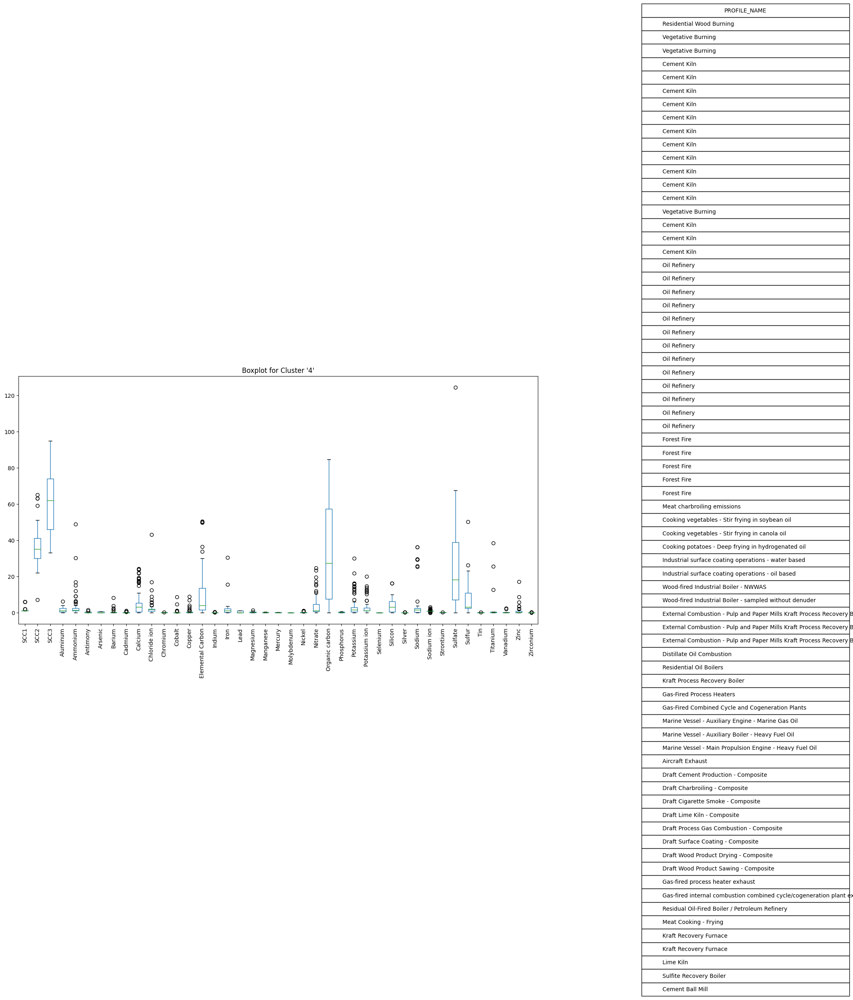

...

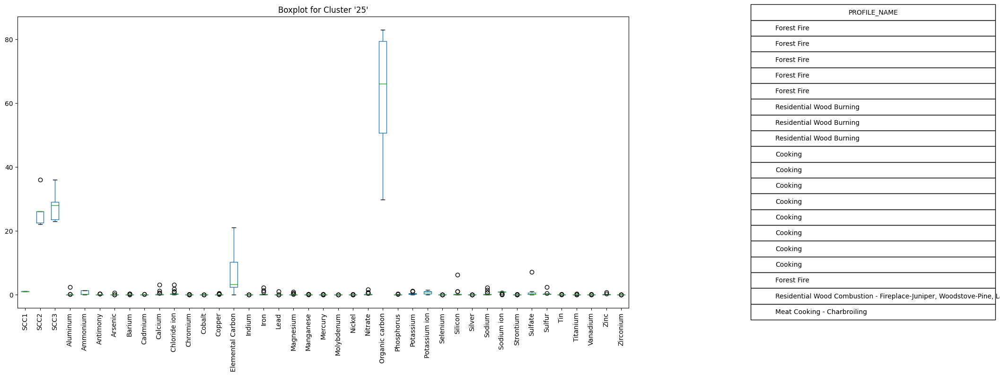

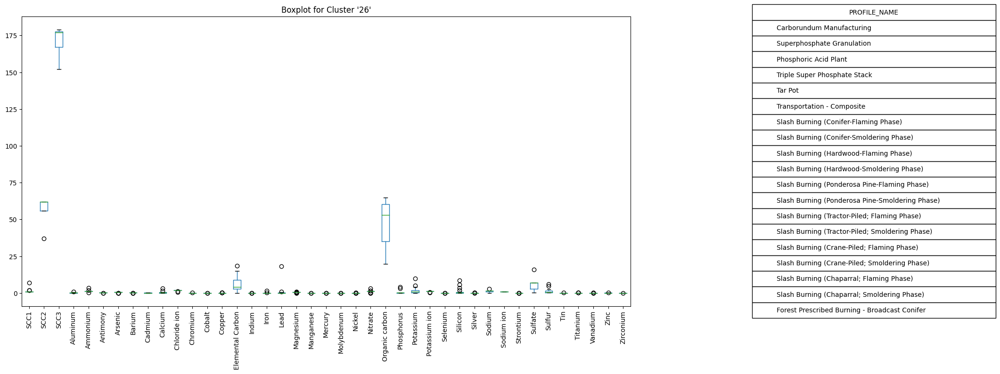

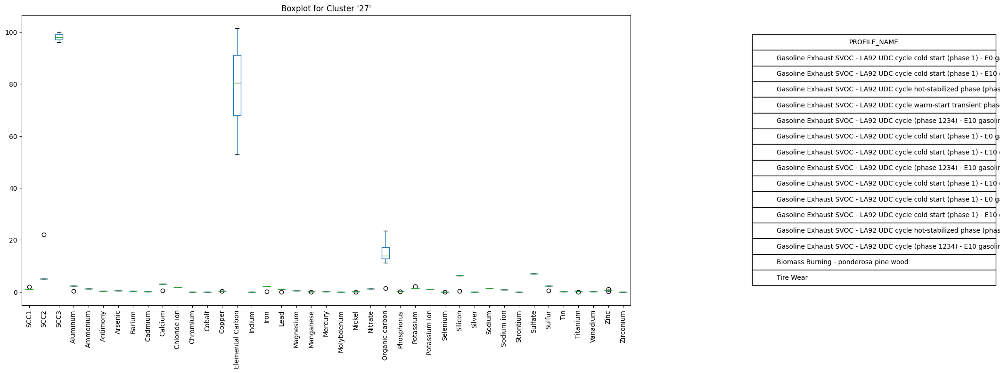

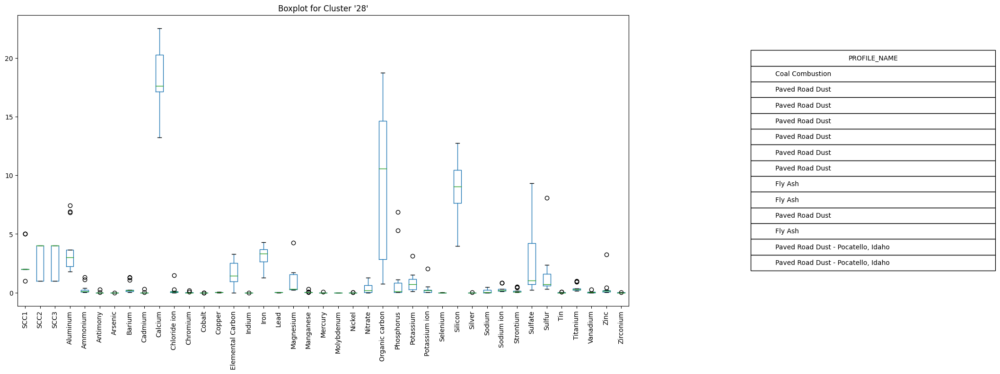

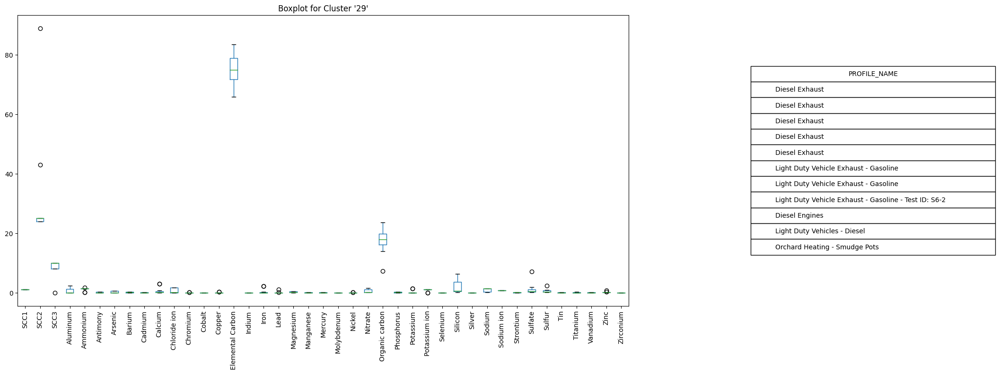

In [886]:

for i, cluster in enumerate(coms.communities):
    selected_rows = pivot_df.loc[cluster]
    
    fig, ax = plt.subplots(figsize=(20, 8))
    selected_rows.iloc[:, 2:45].boxplot(ax=ax, grid=False)
    ax.grid(False)
    
    plt.title(f"Boxplot for Cluster '{i}'")
    plt.xticks(rotation=90)  # Rotate x-labels if needed
    
    # Create a divider for the existing axes instance
    divider = make_axes_locatable(ax)
    ax_table = divider.append_axes("right", size="20%", pad=0.0)
    
    # Hide the axes for the table
    ax_table.axis('off')
    
    # Create the table
    table_data = selected_rows[['PROFILE_NAME']]
    table = ax_table.table(cellText=table_data.values, colLabels=table_data.columns, cellLoc='left', loc='right')
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(2, 2)
    
    plt.show()


## metal vs non-metal

In [887]:
metals = [
    'Aluminum', 'Antimony', 'Cadmium', 'Calcium', 'Chromium', 'Cobalt', 
    'Copper', 'Iron', 'Lead', 'Magnesium', 'Manganese', 'Mercury', 
    'Molybdenum', 'Nickel', 'Potassium', 'Sodium', 'Tin', 'Titanium', 
    'Vanadium', 'Zinc', 'Zirconium'
]

non_metals = [
    'Ammonium', 'Arsenic', 'Bromine', 'Calcium ion', 'Chloride ion', 
    'Chlorine', 'Elemental Carbon', 'Elemental carbon I', 'Elemental carbon II',
    'Elemental carbon III', 'Magnesium ion', 'Nitrate', 'Organic carbon', 
    'Organic carbon I', 'Organic carbon II', 'Organic carbon III', 
    'Organic carbon IV', 'Phosphate', 'Phosphorus', 'Potassium ion', 
    'Pyrolyzed organic carbon', 'Selenium', 'Silicon', 'Sodium ion', 
    'Sulfate', 'Sulfur'
]

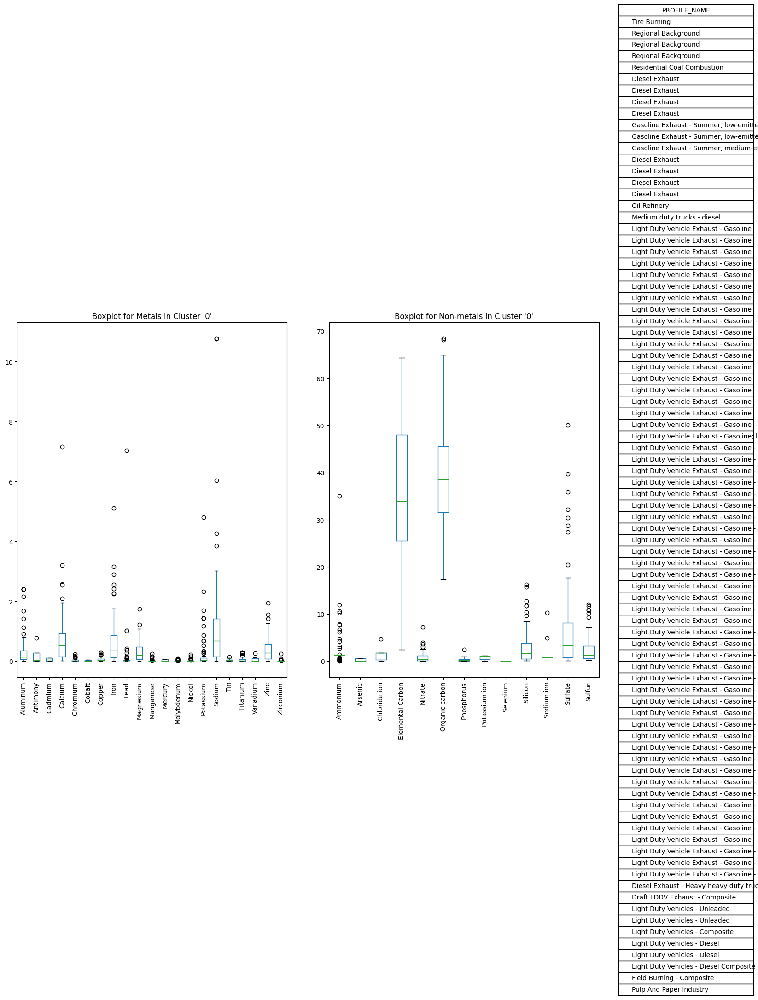

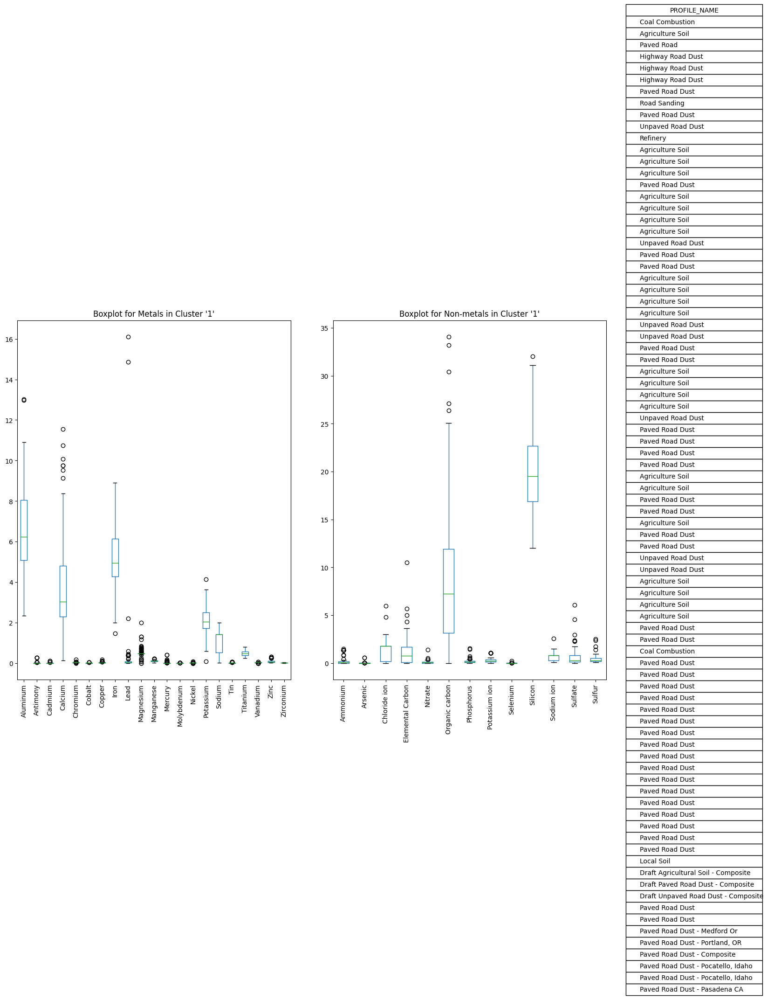

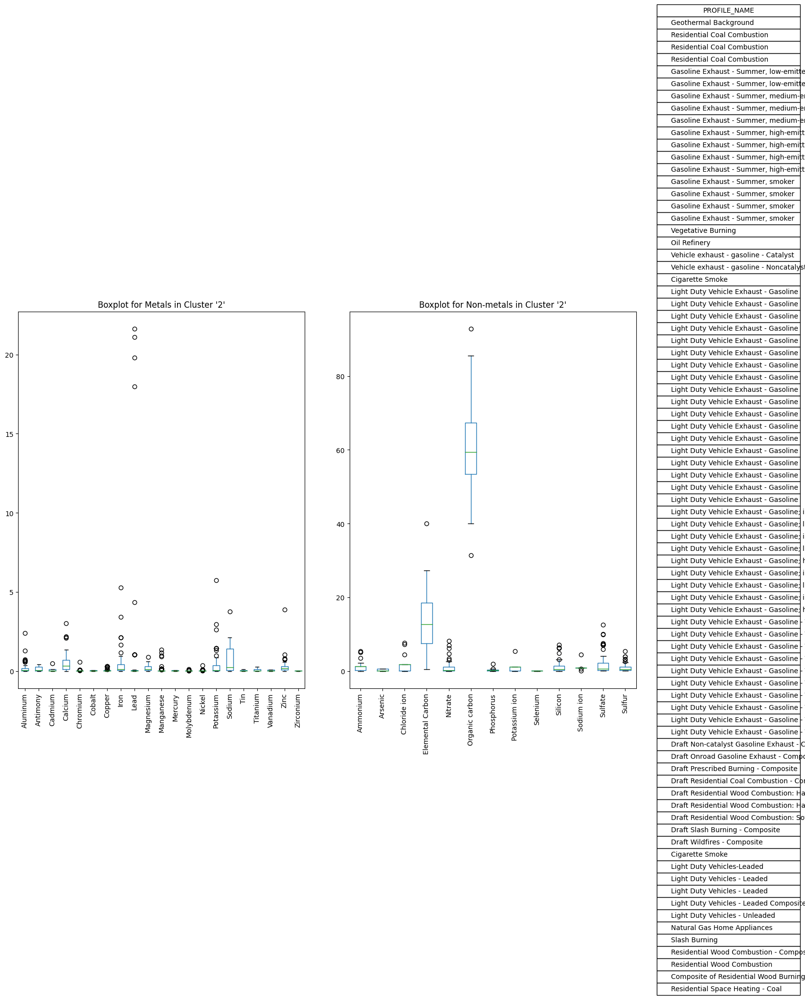

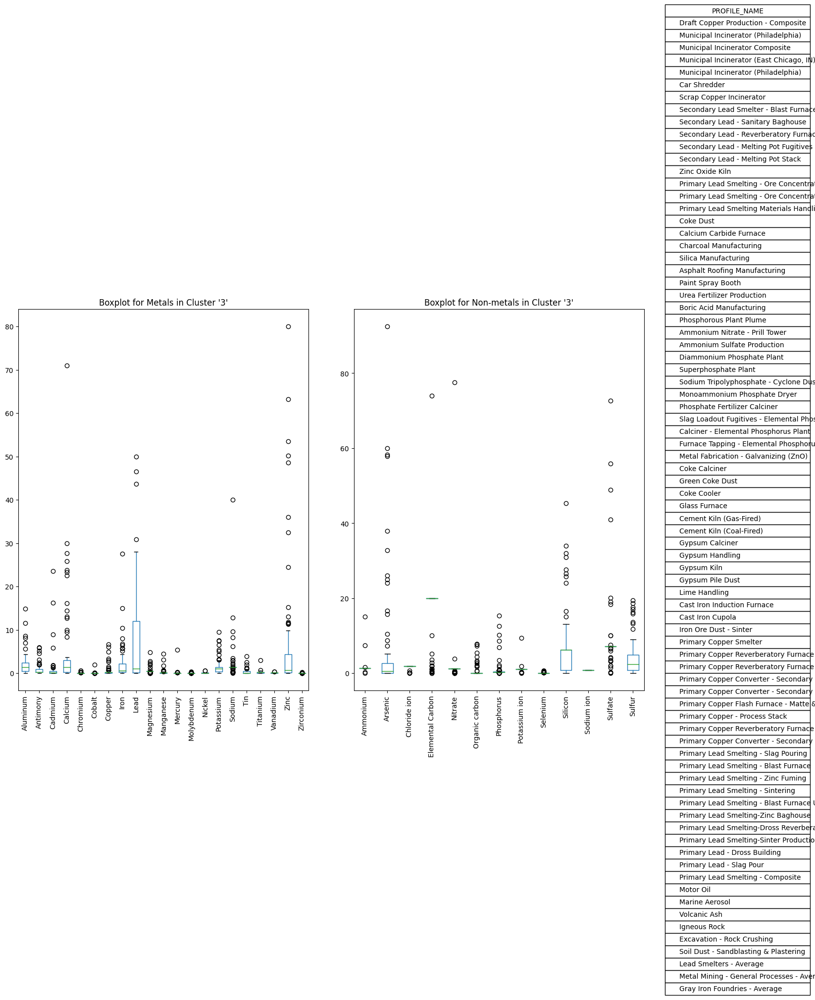

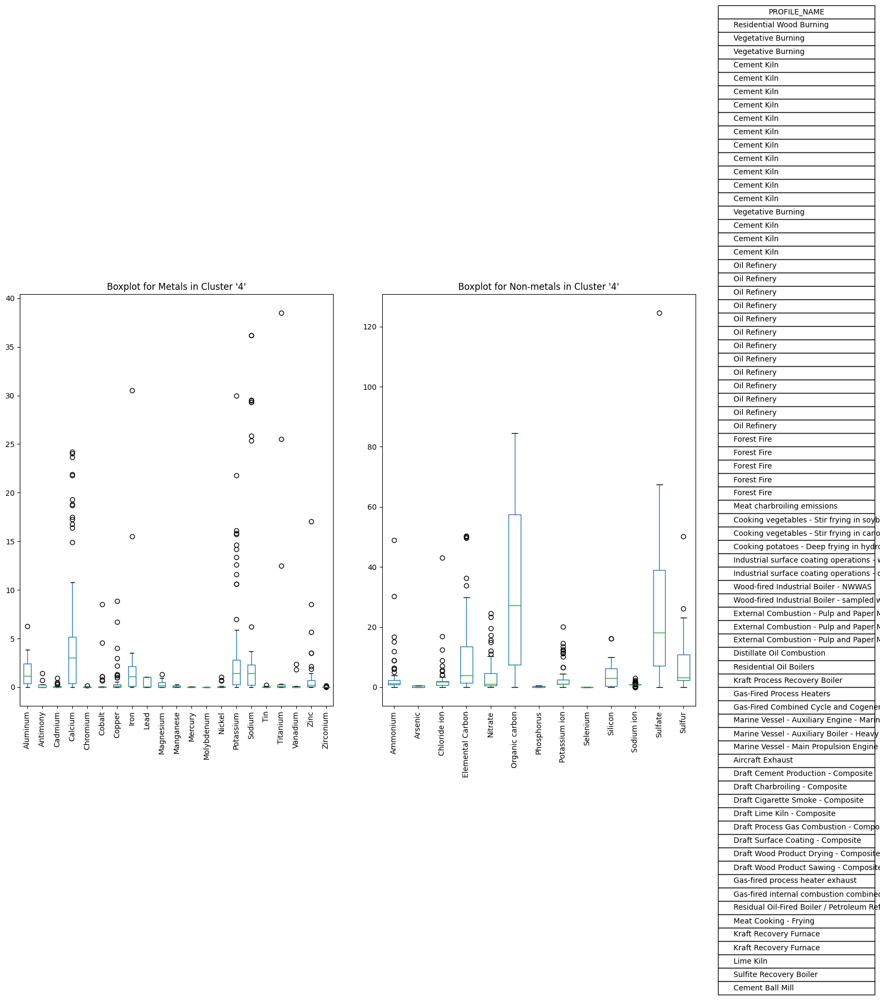

...

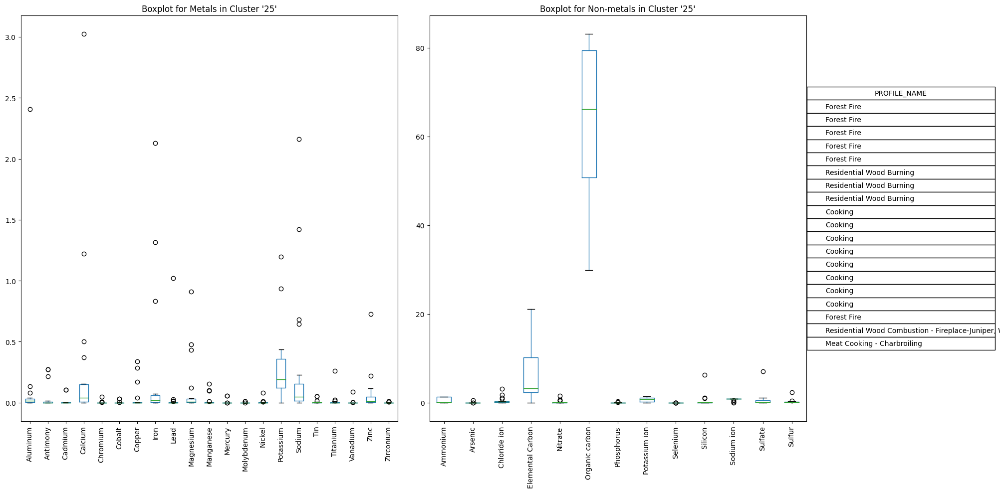

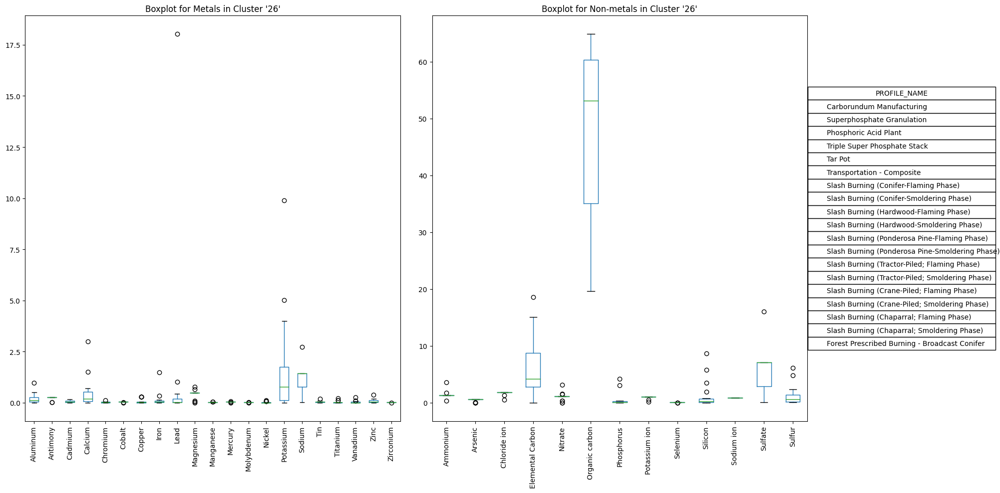

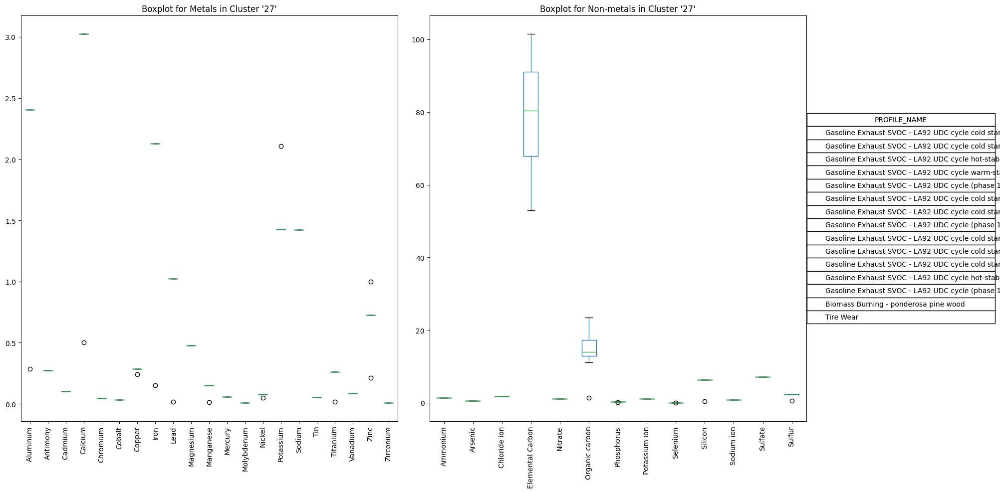

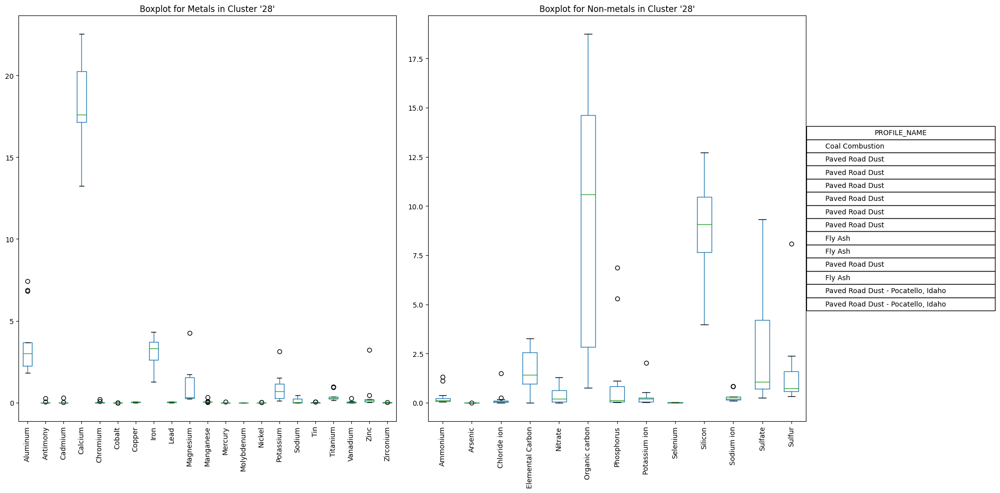

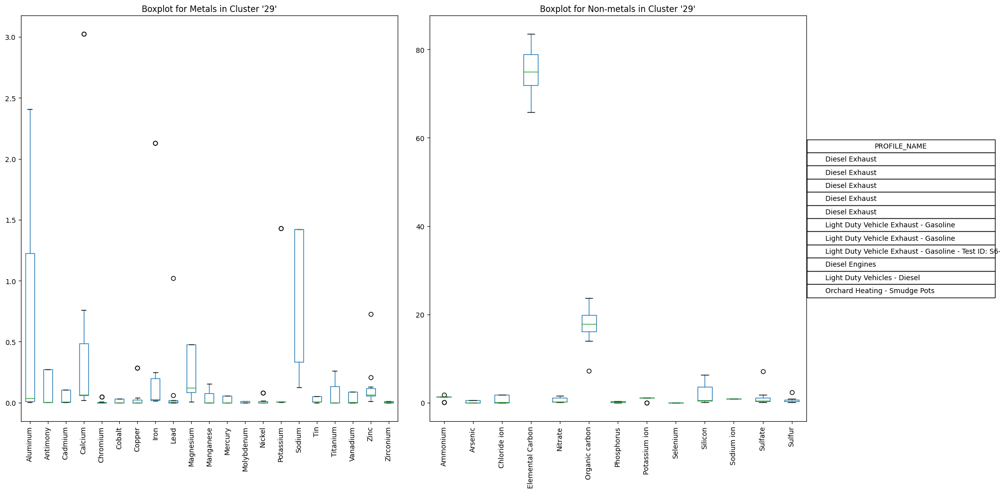

In [888]:
for i, cluster in enumerate(coms.communities):
    selected_rows = pivot_df.loc[cluster]
    
    fig, (ax1, ax2, ax3) = plt.subplots(1, 3, figsize=(20, 10), gridspec_kw={'width_ratios': [3, 3, 1]})
    
    # Filter metals and non-metals to only include columns present in selected_rows
    existing_metals = [metal for metal in metals if metal in selected_rows.columns]
    existing_non_metals = [non_metal for non_metal in non_metals if non_metal in selected_rows.columns]
    
    # Metals subplot
    if existing_metals:
        selected_rows[existing_metals].boxplot(ax=ax1, grid=False)
        ax1.grid(False)
        ax1.set_title(f"Boxplot for Metals in Cluster '{i}'")
        ax1.set_xticklabels(ax1.get_xticklabels(), rotation=90)
    else:
        ax1.axis('off')  # Turn off the subplot if no metals are present
    
    # Non-metals subplot
    if existing_non_metals:
        selected_rows[existing_non_metals].boxplot(ax=ax2, grid=False)
        ax2.grid(False)
        ax2.set_title(f"Boxplot for Non-metals in Cluster '{i}'")
        ax2.set_xticklabels(ax2.get_xticklabels(), rotation=90)
    else:
        ax2.axis('off')  # Turn off the subplot if no non-metals are present
    
    # Create the third subplot for the table
    ax3.axis('off')
    
    # Create the table
    table_data = selected_rows[['PROFILE_NAME']]
    table = ax3.table(cellText=table_data.values, colLabels=table_data.columns, cellLoc='left', loc='center')
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(1.5, 1.5)
    
    plt.tight_layout()
    plt.show()

### top 5 species

Index(['Organic carbon', 'Elemental Carbon', 'SCC2', 'Sulfate', 'Ammonium'], dtype='object')


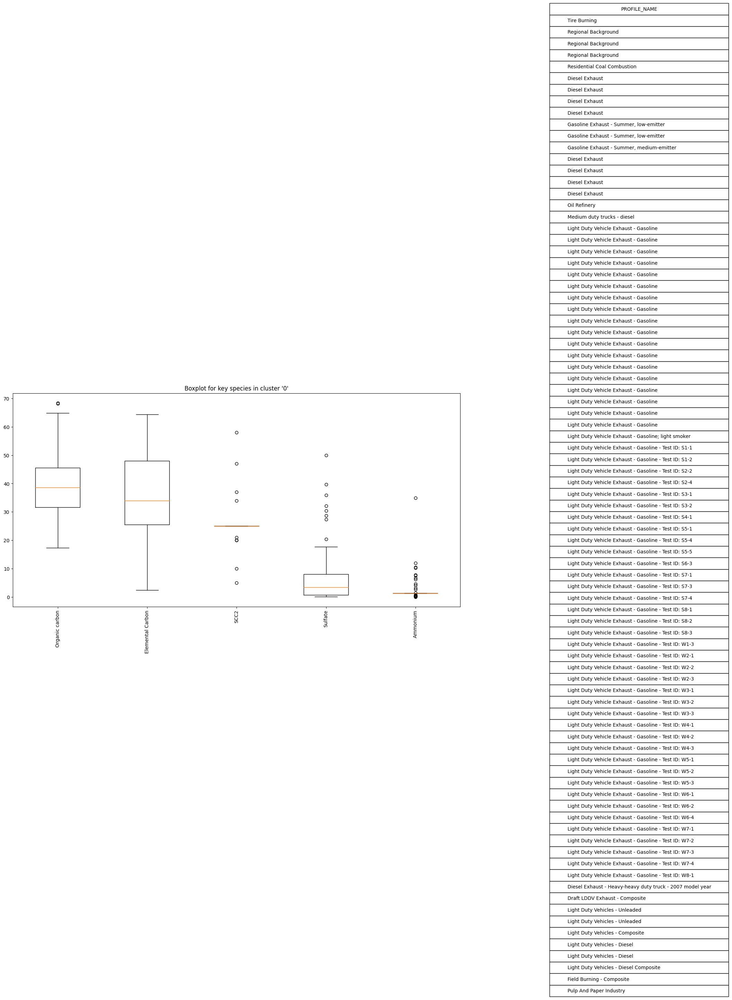

Index(['Silicon', 'Organic carbon', 'Aluminum', 'Calcium', 'Iron'], dtype='object')


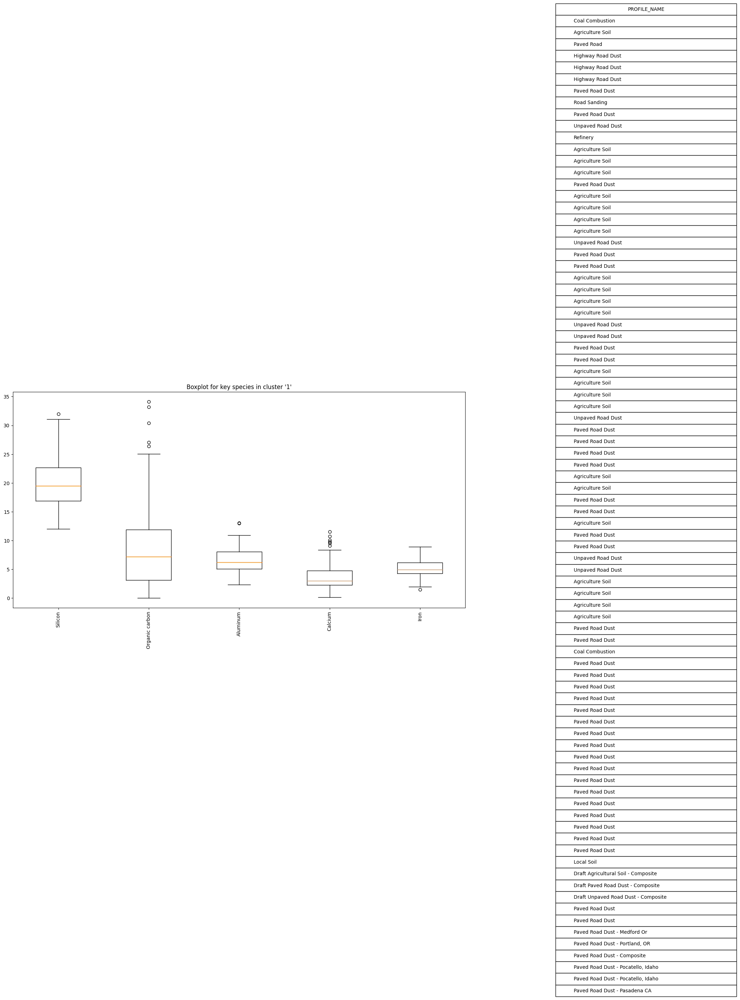

Index(['Organic carbon', 'SCC2', 'Elemental Carbon', 'Lead', 'SCC3'], dtype='object')


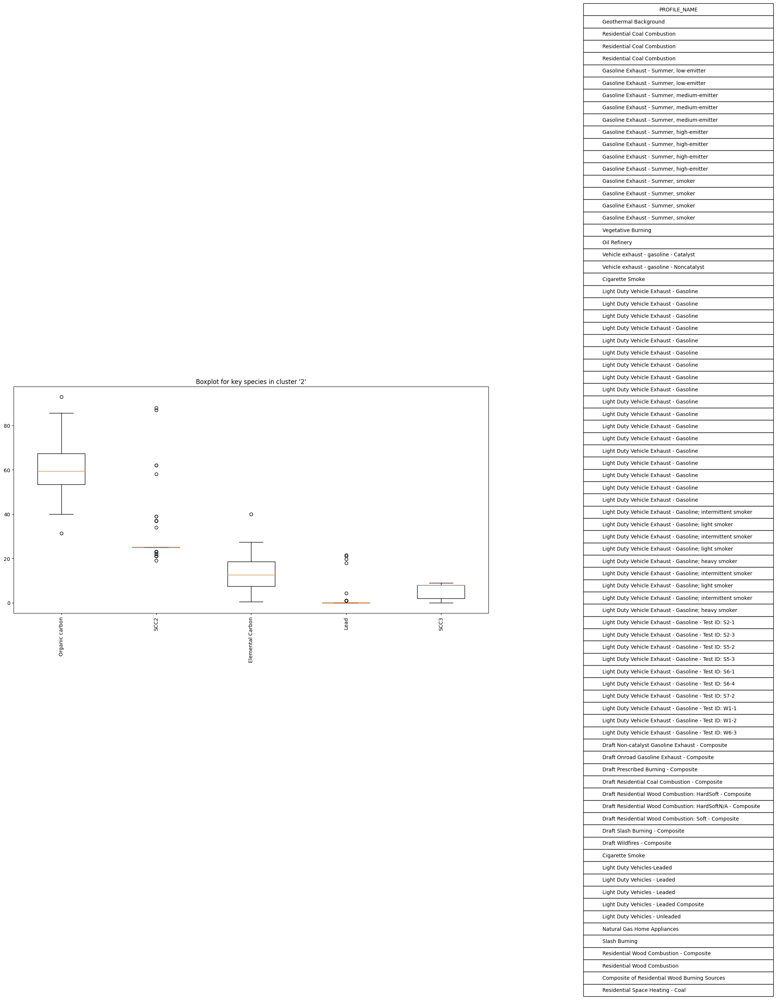

Index(['SCC3', 'SCC2', 'Arsenic', 'Zinc', 'Elemental Carbon'], dtype='object')


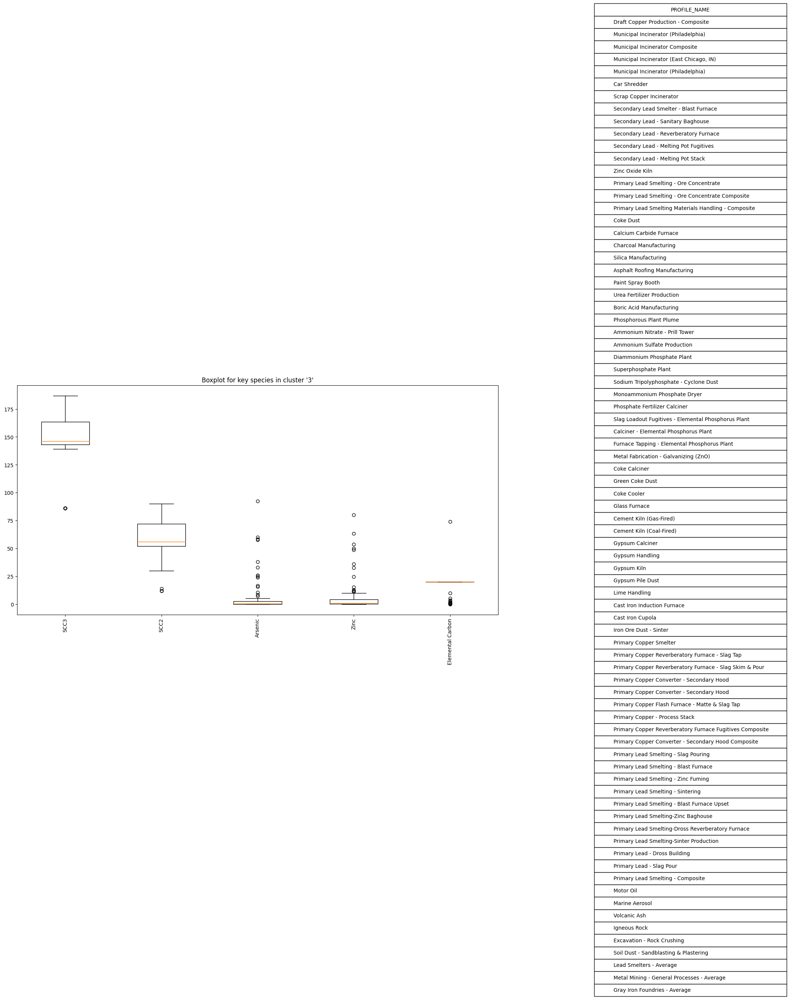

Index(['SCC3', 'Organic carbon', 'Sulfate', 'SCC2', 'Elemental Carbon'], dtype='object')


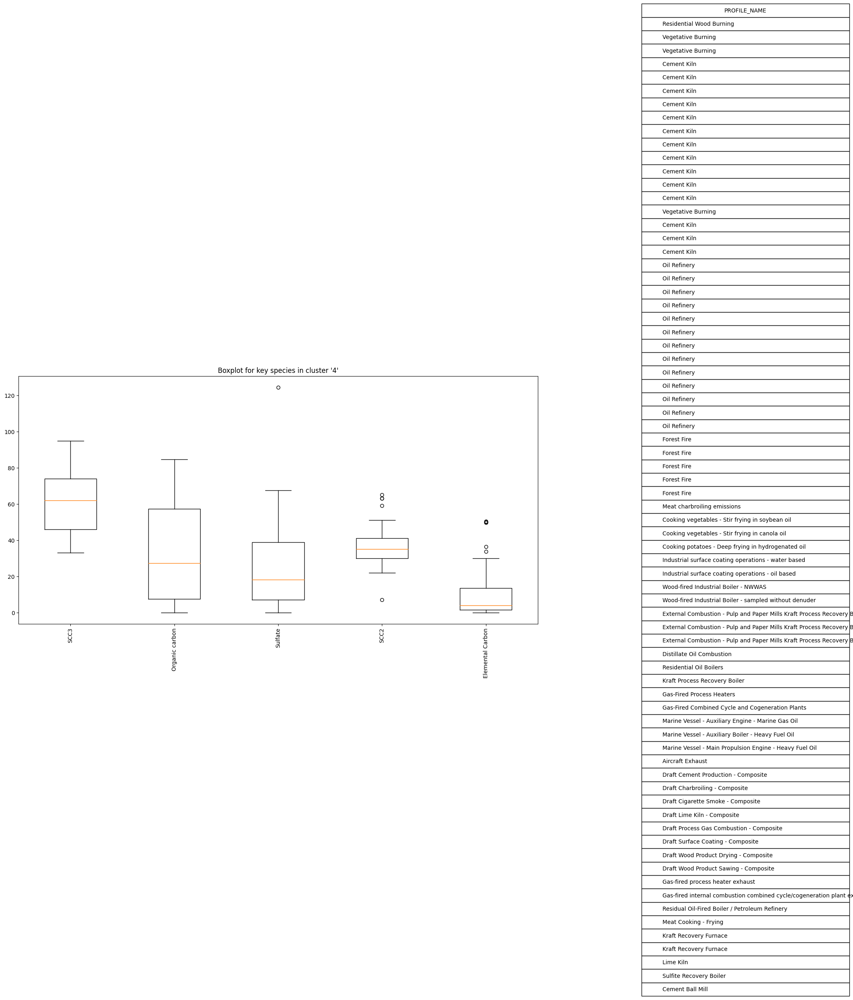

Index(['SCC3', 'Organic carbon', 'Elemental Carbon', 'SCC2', 'Potassium'], dtype='object')


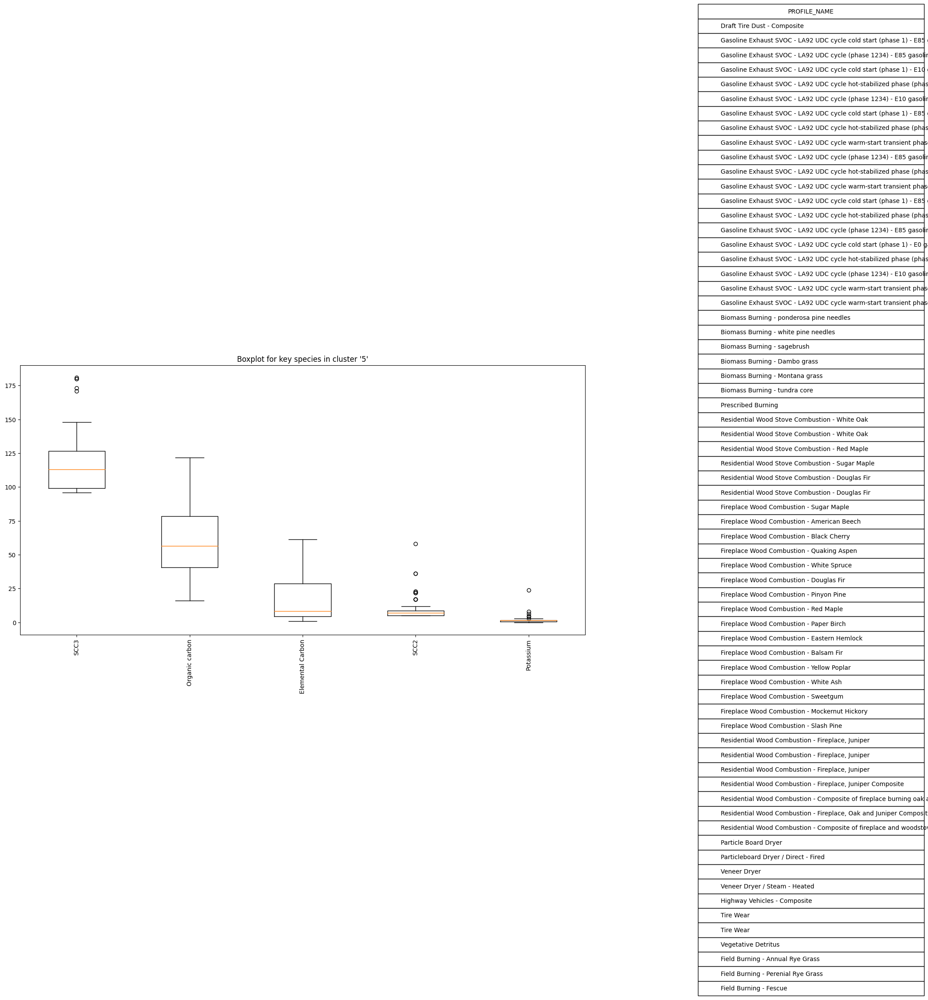

Index(['Organic carbon', 'Elemental Carbon', 'SCC3', 'Nitrate', 'Potassium'], dtype='object')


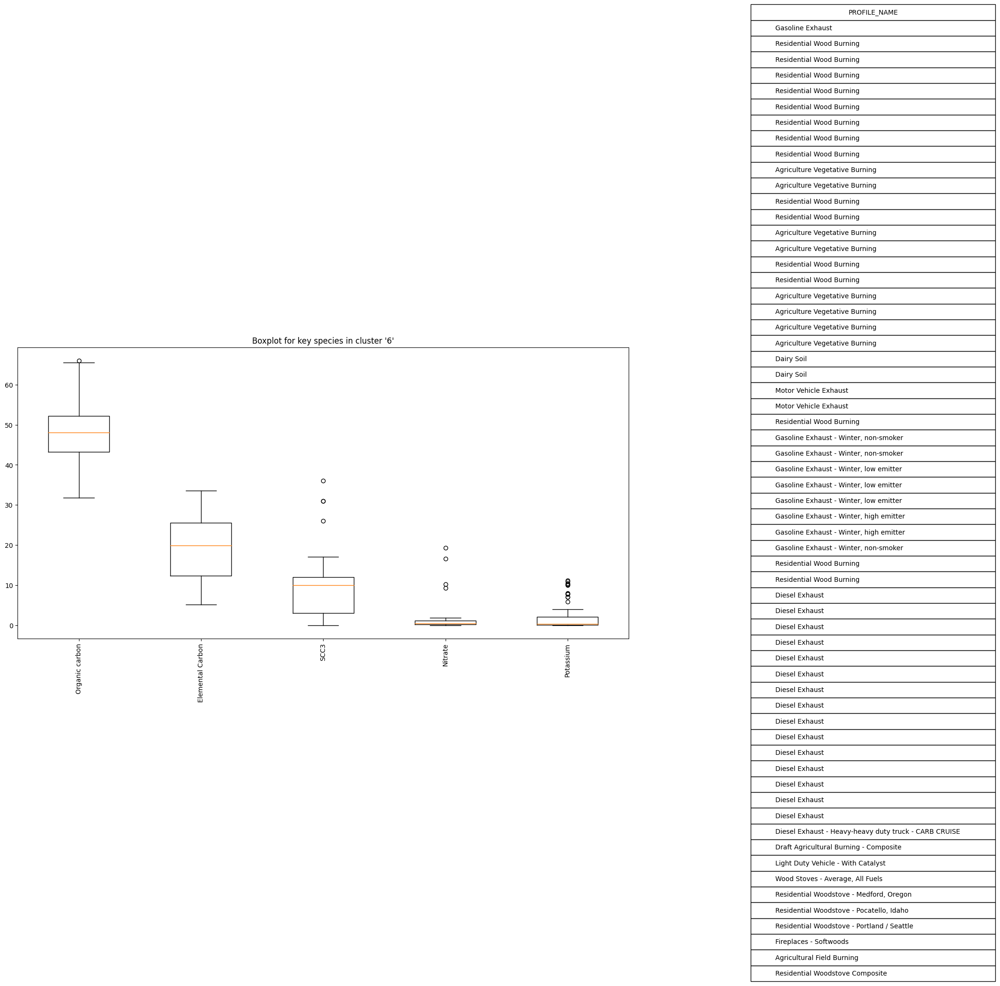

Index(['Chloride ion', 'Sulfate', 'Nitrate', 'SCC2', 'Organic carbon'], dtype='object')


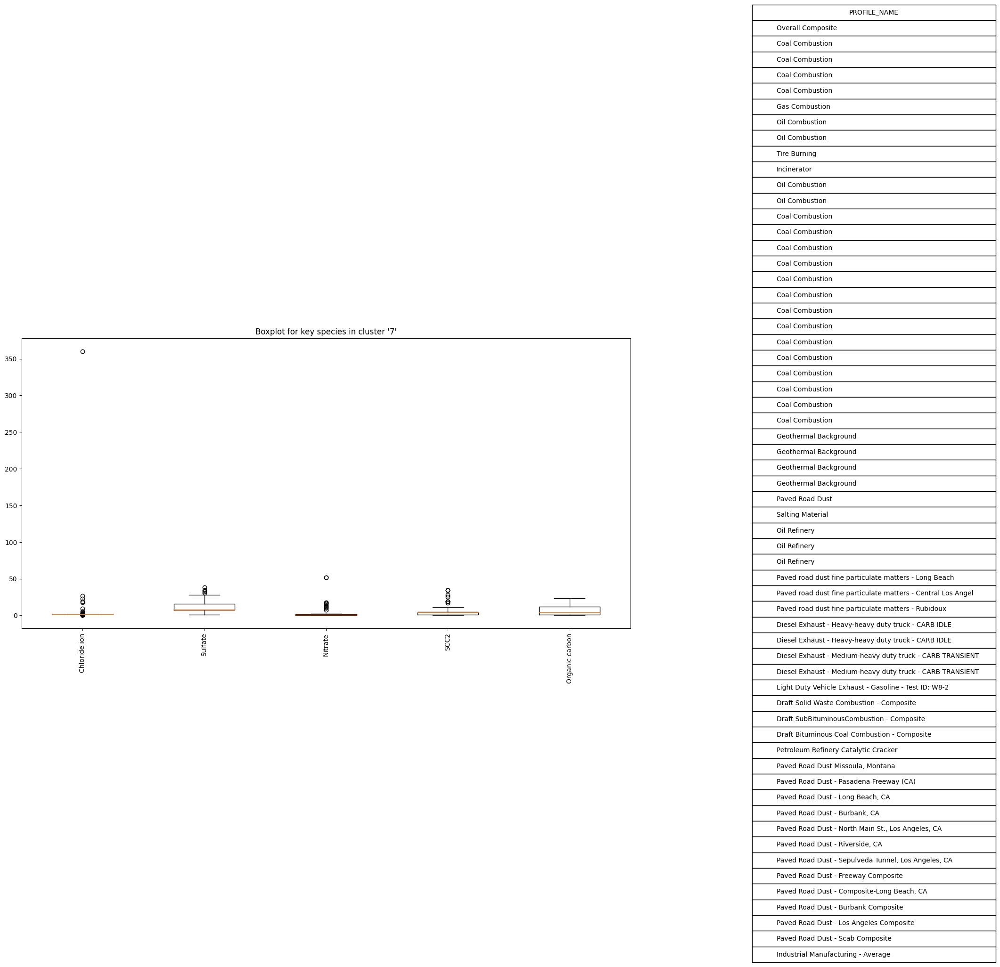

Index(['Organic carbon', 'Elemental Carbon', 'SCC2', 'SCC3', 'Sulfate'], dtype='object')


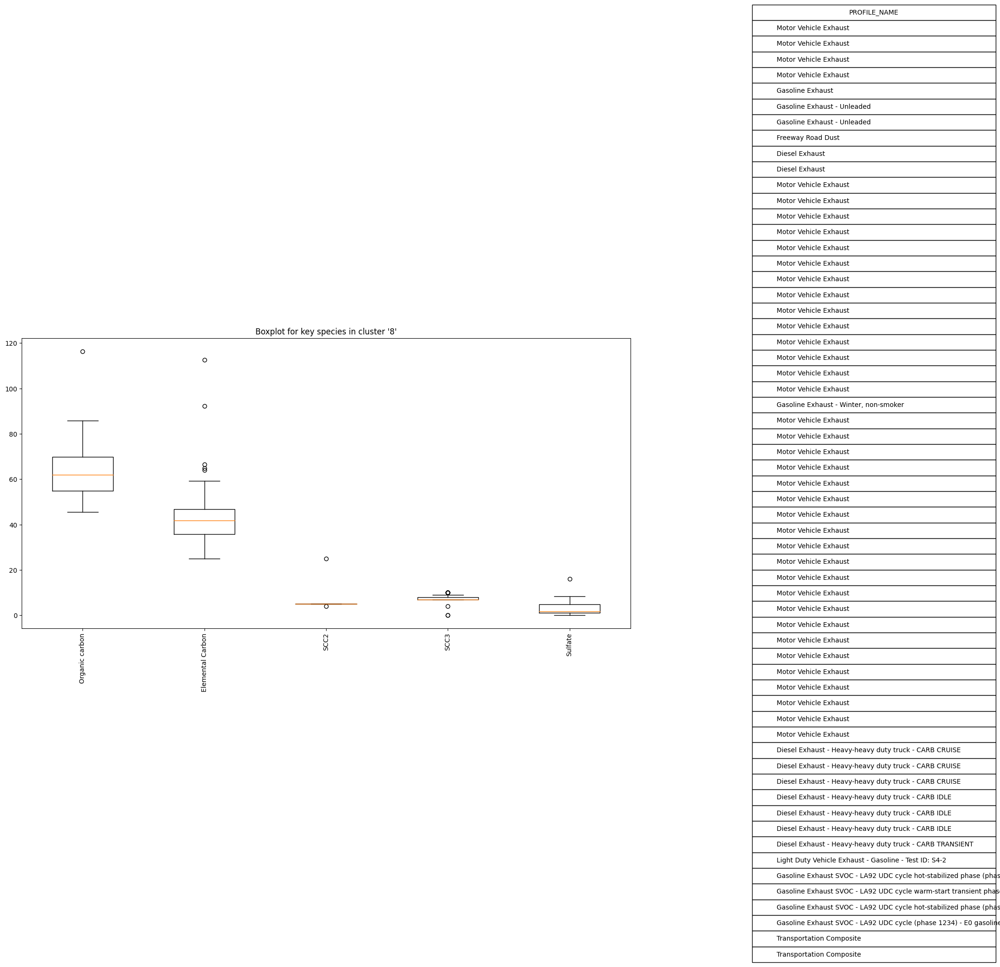

Index(['Silicon', 'Elemental Carbon', 'Aluminum', 'SCC2', 'SCC3'], dtype='object')


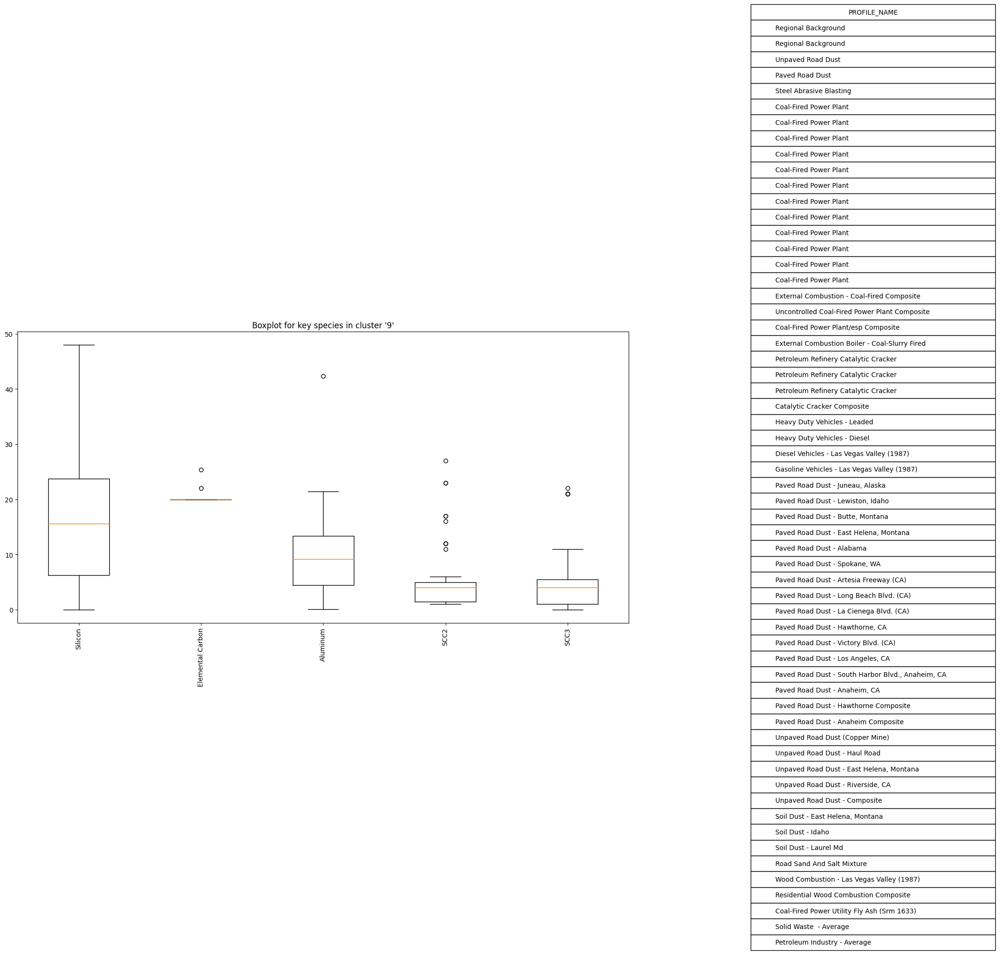

Index(['Organic carbon', 'SCC3', 'SCC2', 'Elemental Carbon', 'Chloride ion'], dtype='object')


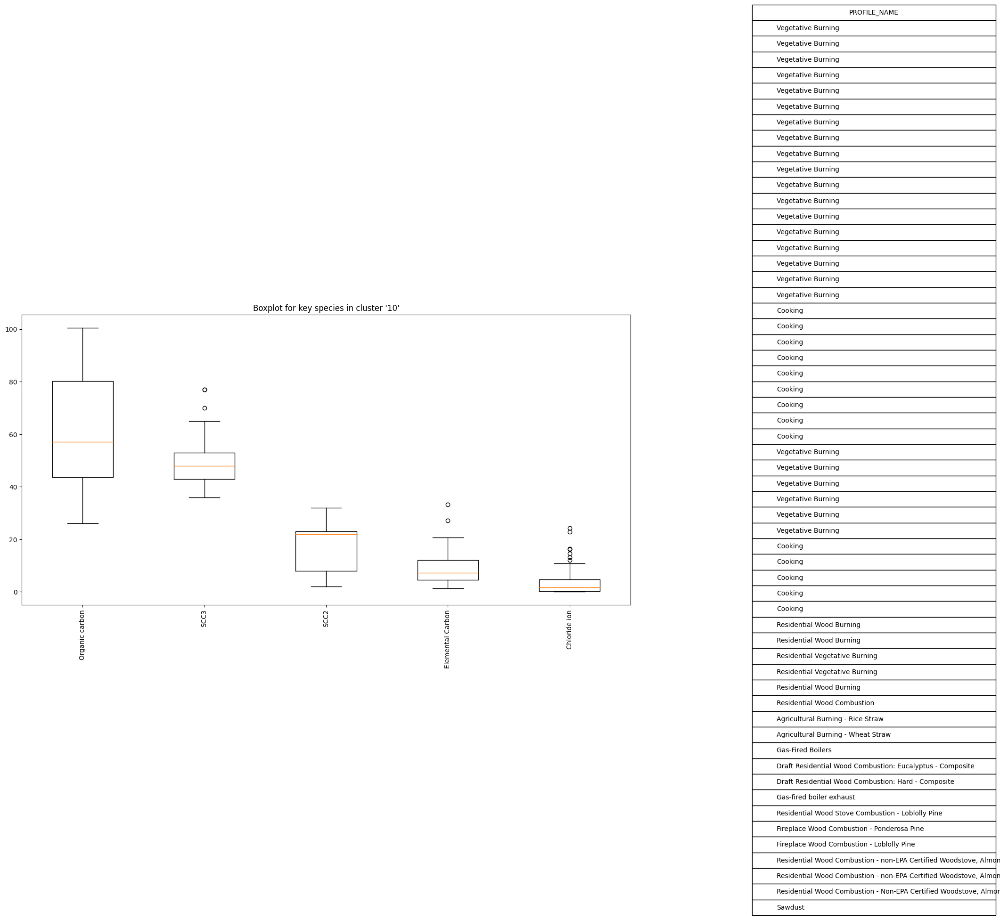

Index(['Elemental Carbon', 'Organic carbon', 'Sulfate', 'SCC3', 'Sulfur'], dtype='object')


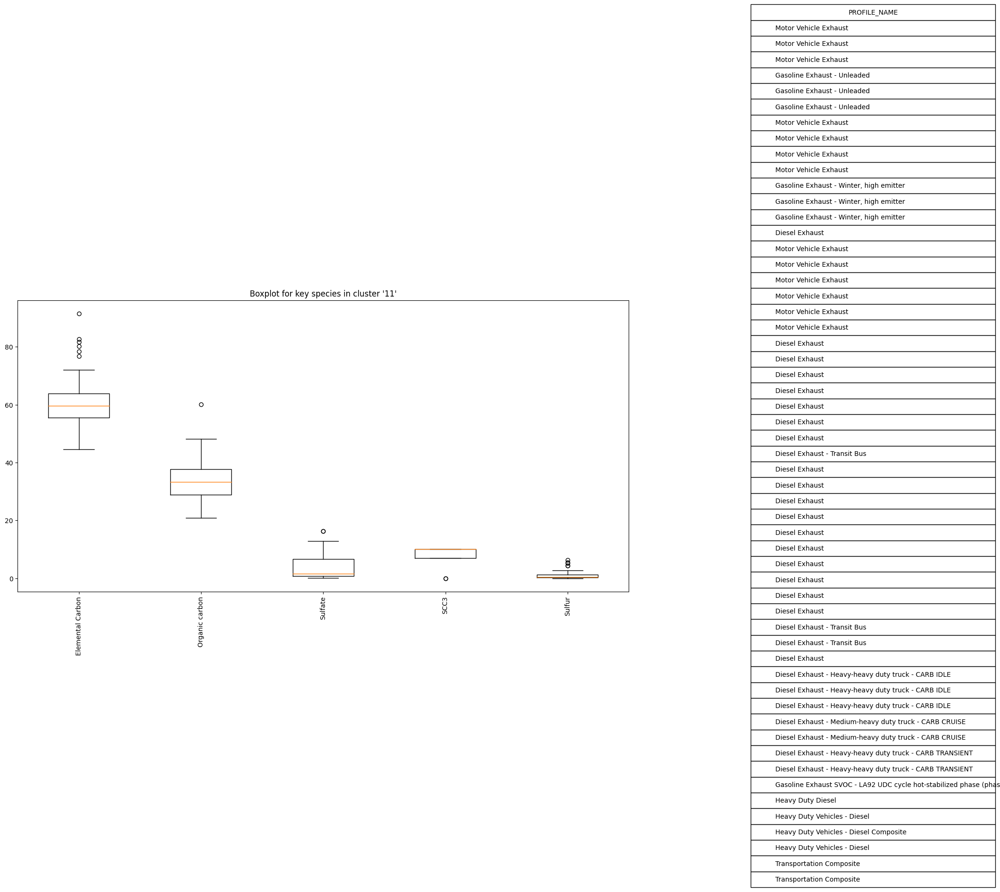

Index(['Silicon', 'SCC2', 'Calcium', 'Organic carbon', 'Sulfate'], dtype='object')


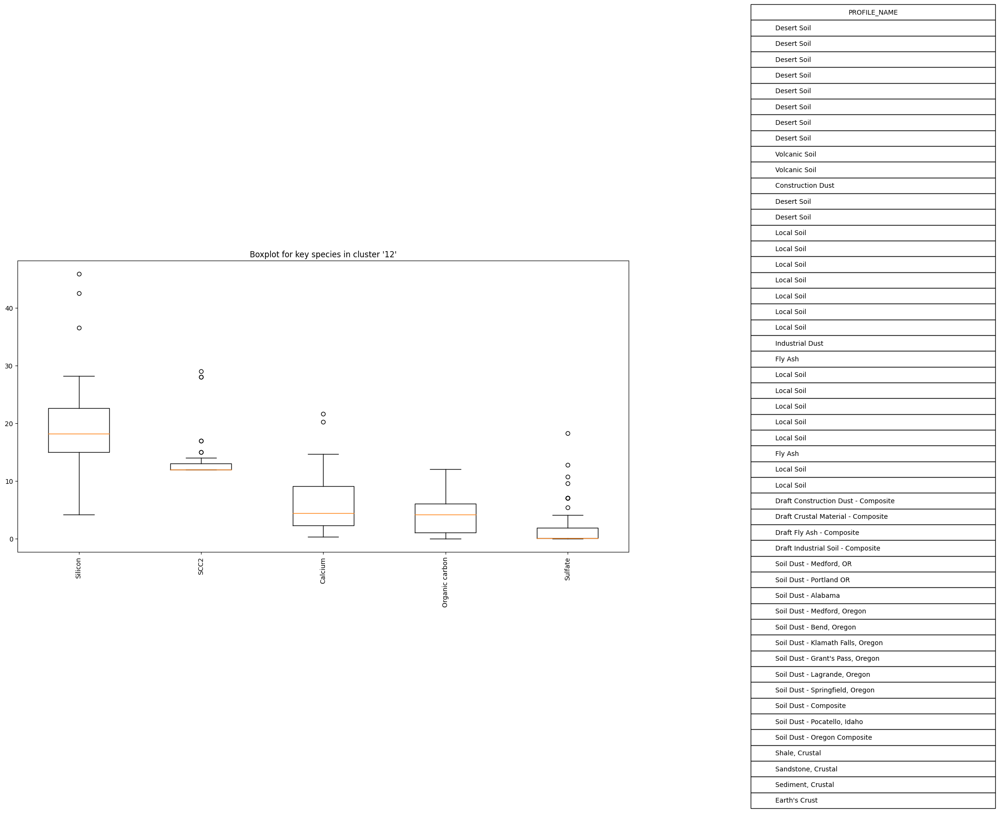

Index(['Organic carbon', 'Elemental Carbon', 'Lead', 'Mercury', 'SCC3'], dtype='object')


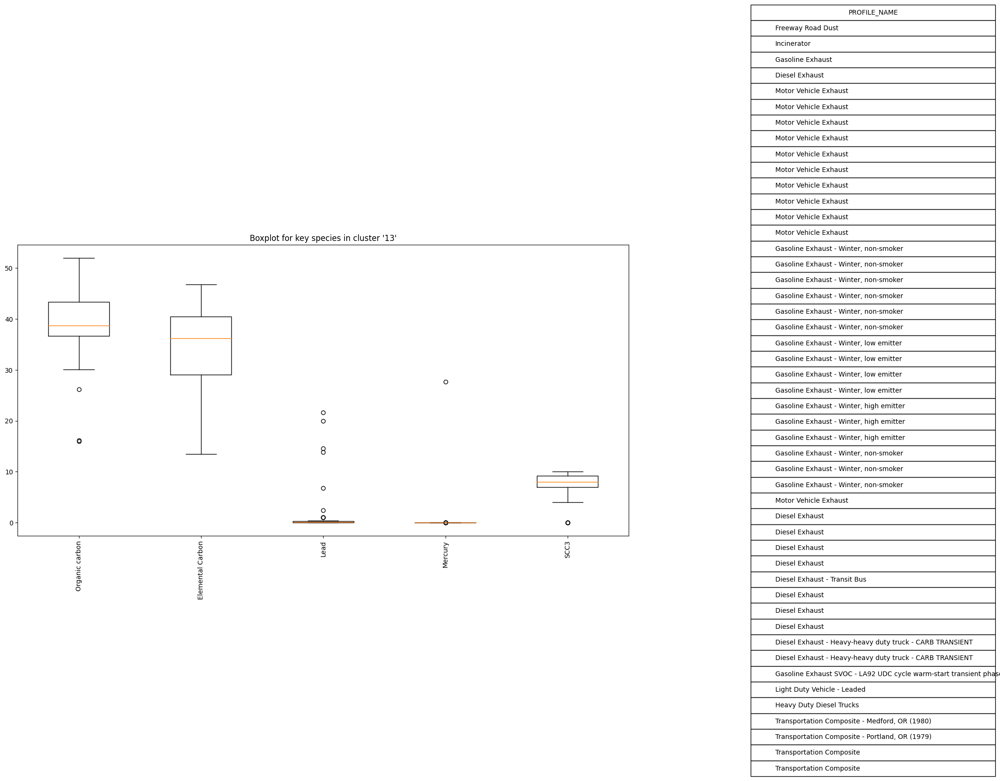

Index(['Sulfate', 'Organic carbon', 'Calcium', 'Sulfur', 'Silicon'], dtype='object')


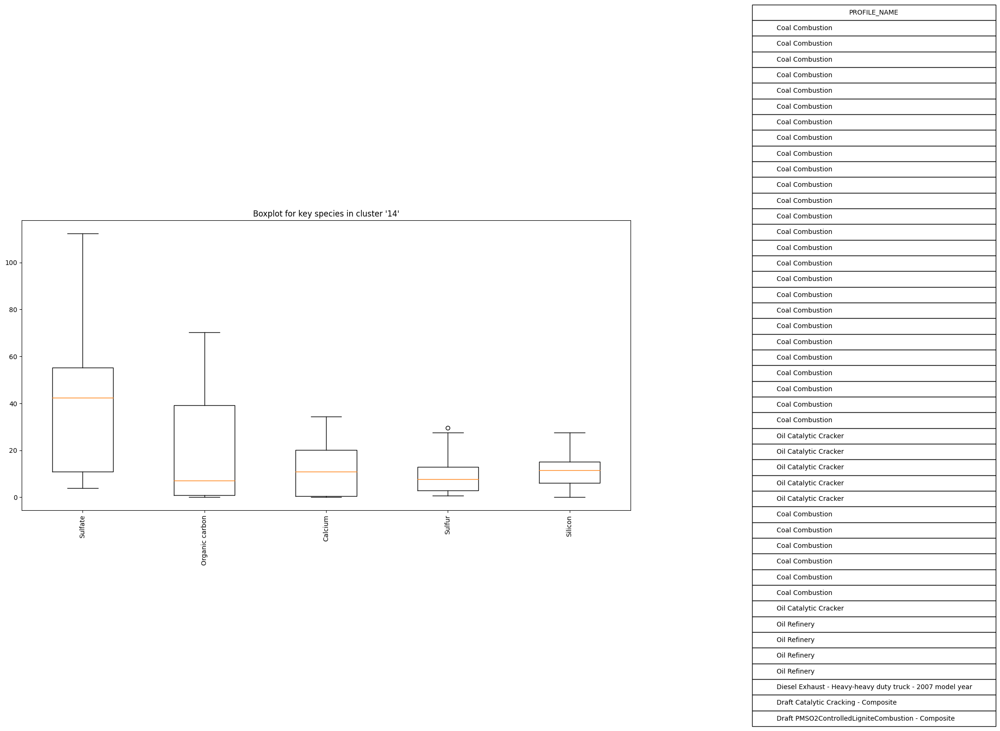

Index(['SCC3', 'SCC2', 'Elemental Carbon', 'Copper', 'Organic carbon'], dtype='object')


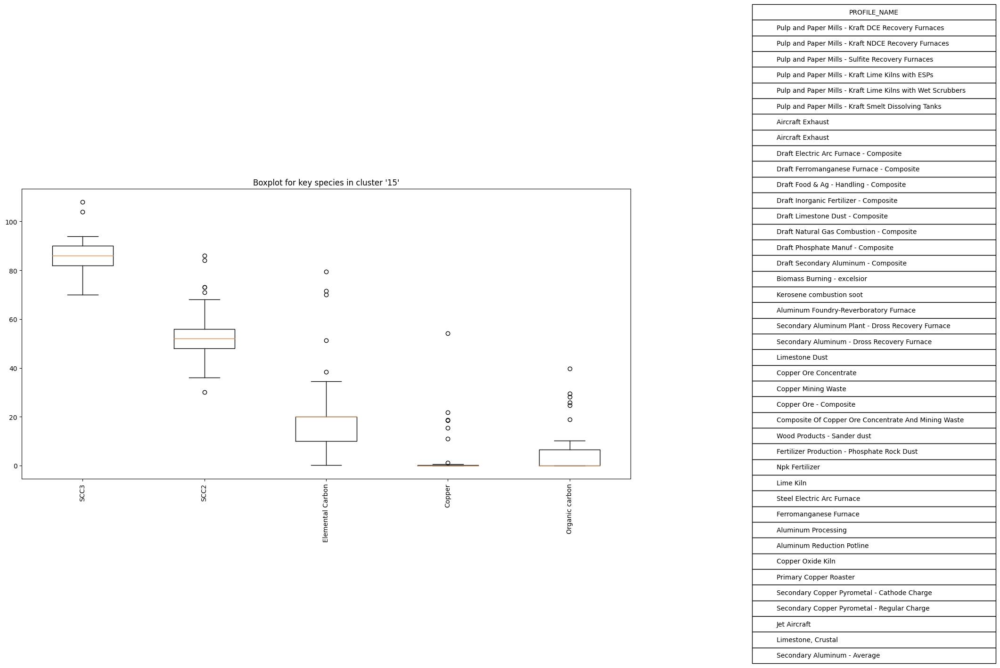

Index(['SCC3', 'Antimony', 'Sulfate', 'Lead', 'SCC2'], dtype='object')


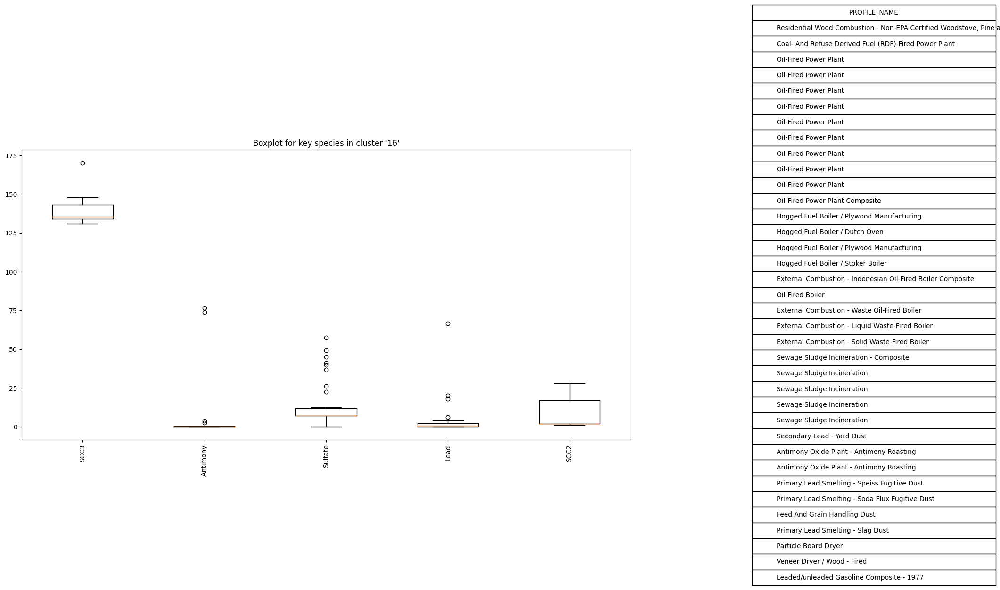

Index(['Elemental Carbon', 'Organic carbon', 'SCC3', 'Sulfate', 'Silicon'], dtype='object')


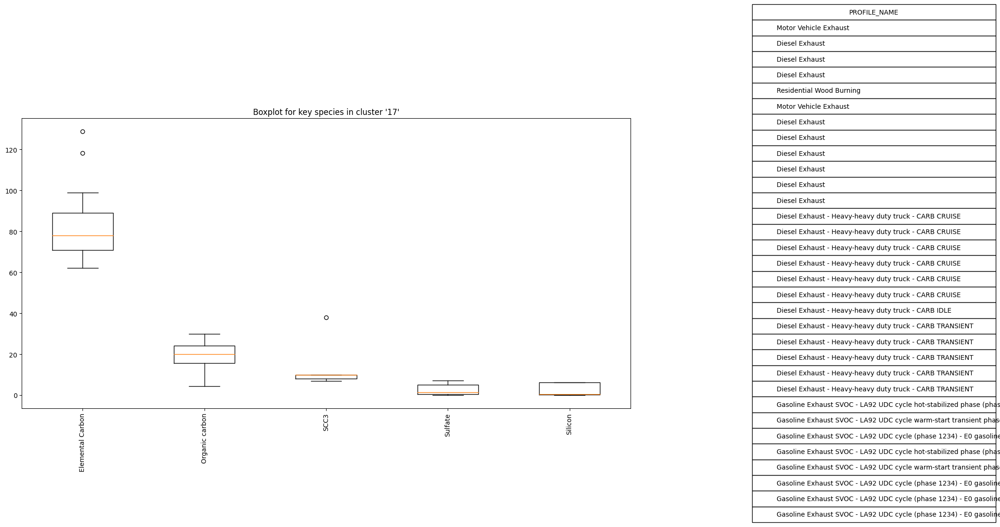

Index(['Organic carbon', 'SCC3', 'Elemental Carbon', 'Potassium', 'Sodium'], dtype='object')


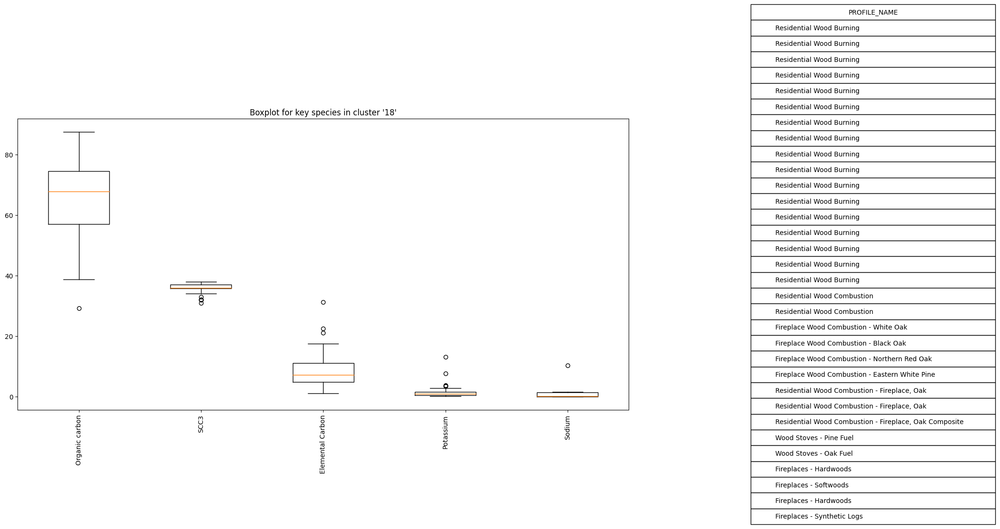

Index(['Silicon', 'Elemental Carbon', 'Calcium', 'SCC3', 'SCC2'], dtype='object')


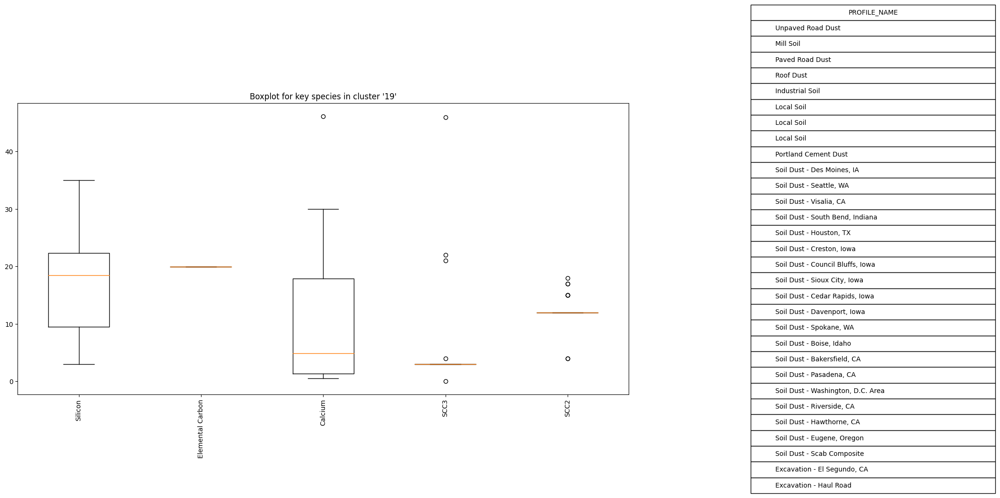

Index(['Organic carbon', 'Elemental Carbon', 'SCC3', 'Silicon', 'Lead'], dtype='object')


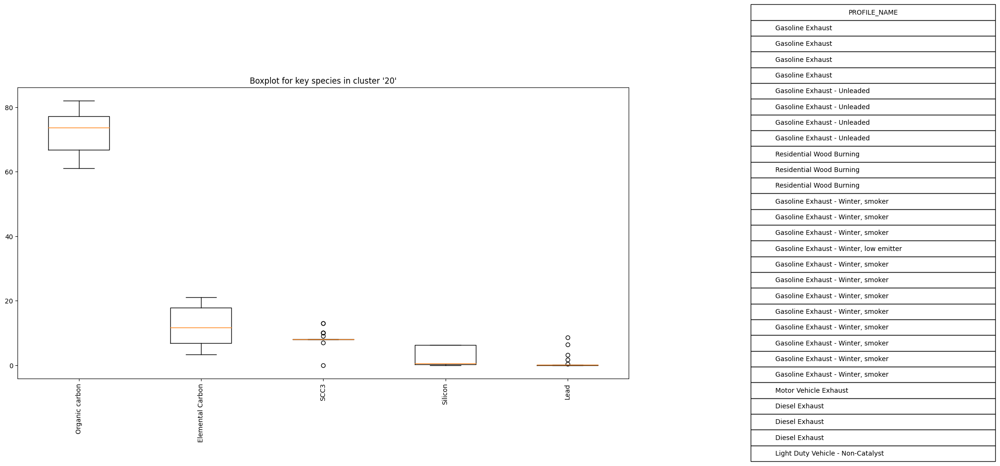

Index(['SCC3', 'Sulfate', 'Elemental Carbon', 'Silicon', 'Iron'], dtype='object')


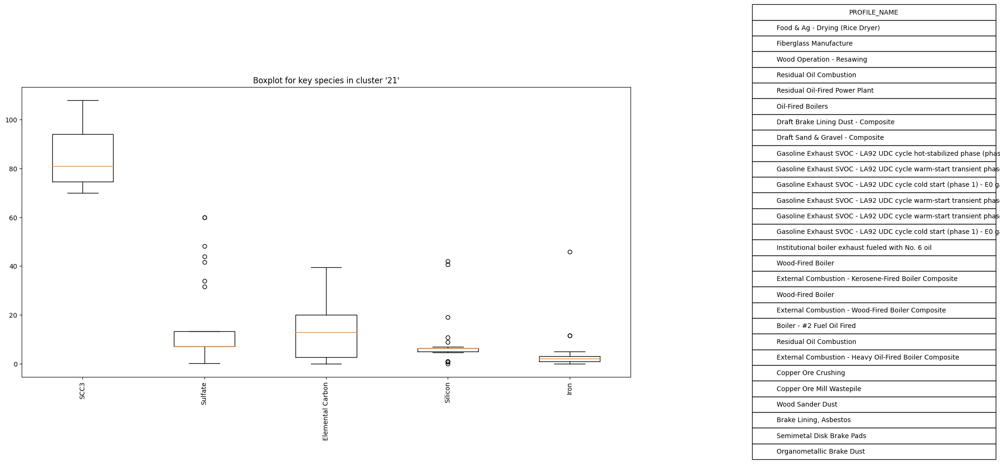

Index(['Organic carbon', 'SCC3', 'Elemental Carbon', 'SCC2', 'Silicon'], dtype='object')


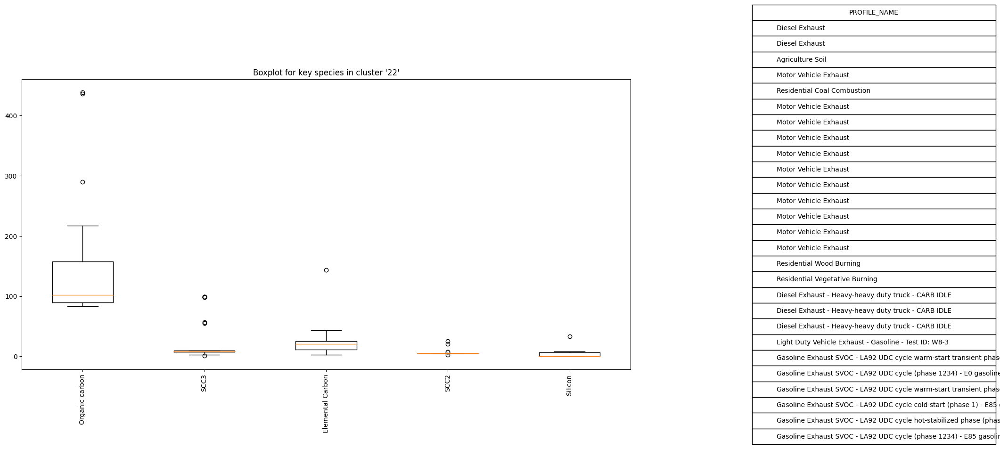

Index(['SCC3', 'Silicon', 'Calcium', 'SCC2', 'Organic carbon'], dtype='object')


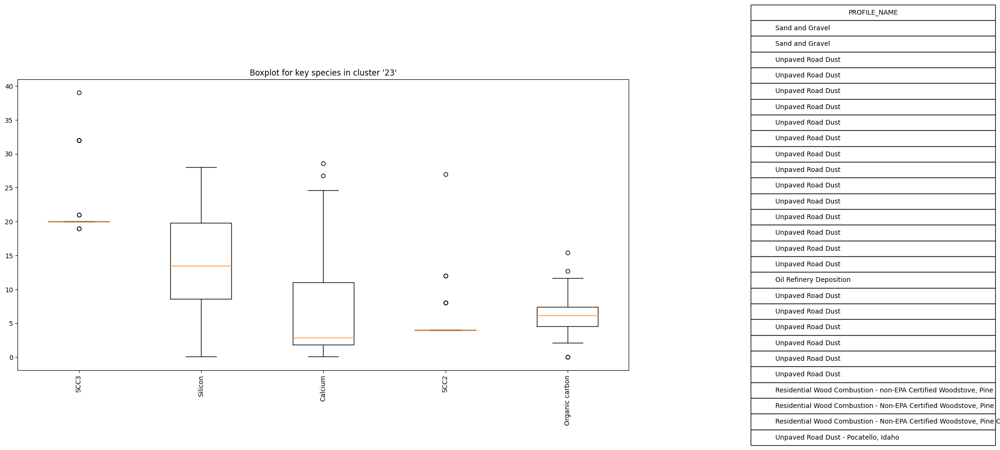

Index(['SCC2', 'Sulfate', 'Iron', 'Elemental Carbon', 'Silicon'], dtype='object')


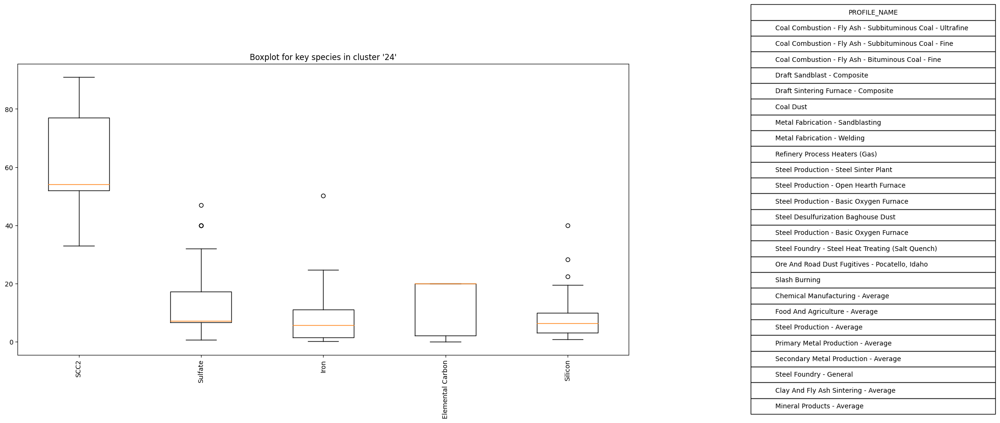

Index(['Organic carbon', 'SCC3', 'SCC2', 'Elemental Carbon', 'Sulfate'], dtype='object')


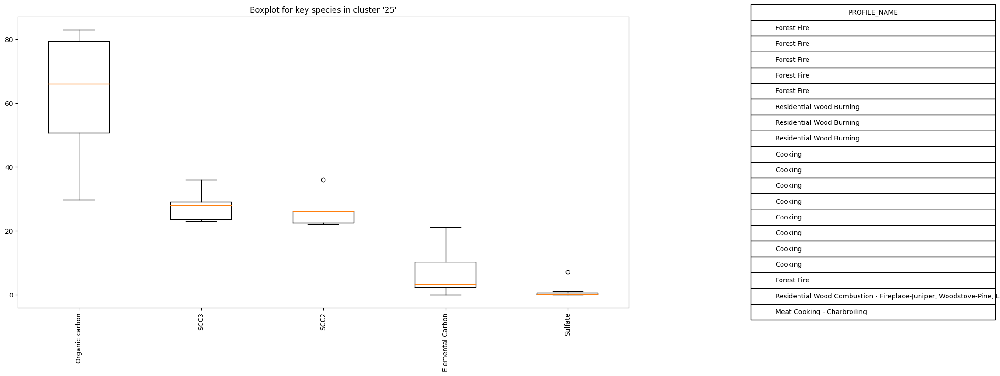

Index(['SCC3', 'Organic carbon', 'SCC2', 'Elemental Carbon', 'Sulfate'], dtype='object')


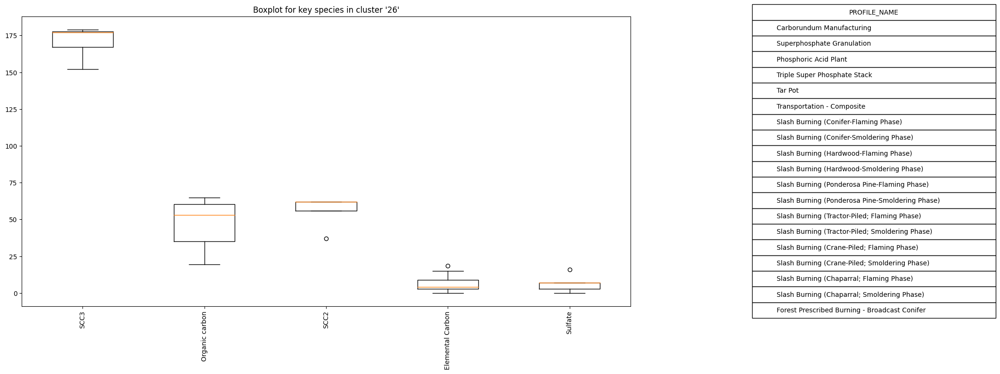

Index(['SCC3', 'Elemental Carbon', 'Organic carbon', 'SCC2', 'Silicon'], dtype='object')


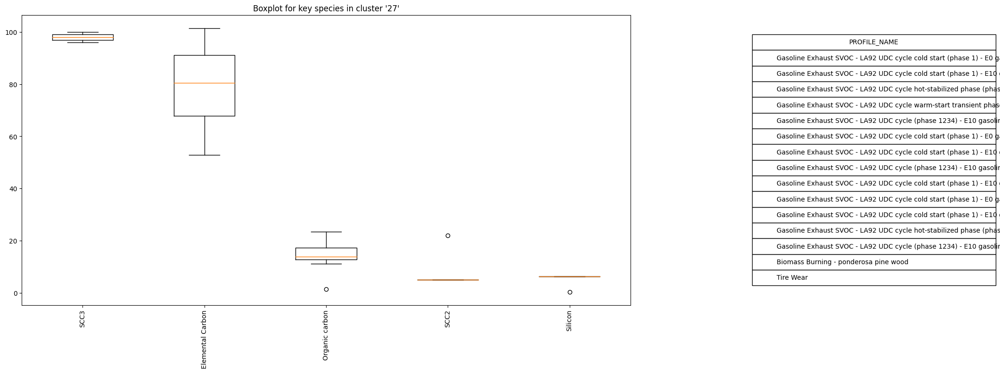

Index(['Calcium', 'Organic carbon', 'Silicon', 'Sulfate', 'Phosphorus'], dtype='object')


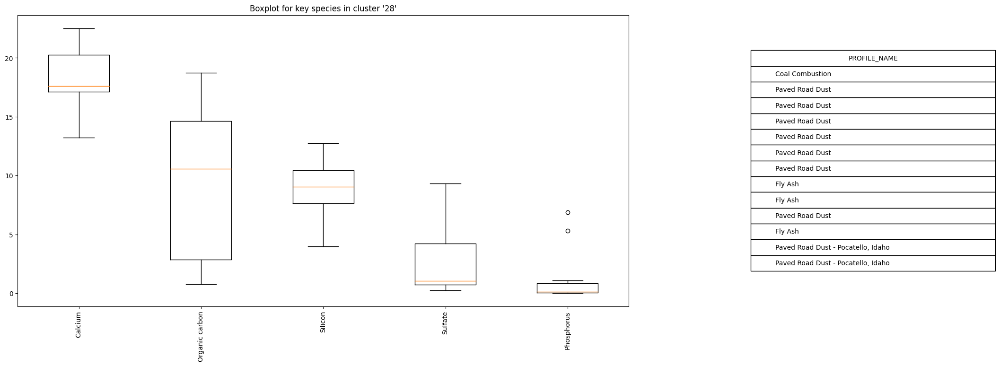

Index(['Elemental Carbon', 'SCC2', 'Organic carbon', 'Silicon', 'SCC3'], dtype='object')


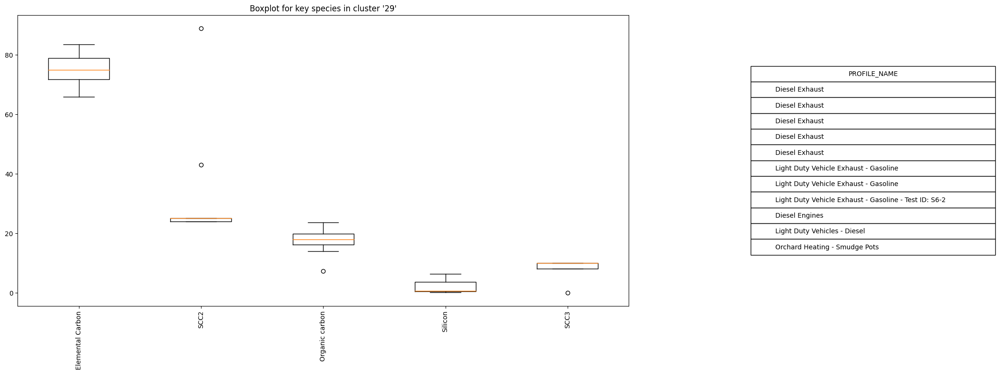

In [889]:
k_species = 5


for i, cluster in enumerate(coms.communities):
    
    selected_rows = pivot_df.loc[cluster]

    selected_columns = selected_rows.iloc[:,3:]
    
    
    
    U, S, Vt = np.linalg.svd(selected_columns, full_matrices=False)
    
    
    column_importance = np.sum(np.matmul(np.diag(S),Vt**2), axis=0)
    important_columns_indices = np.argsort(-column_importance)[:k_species]
    
    important_columns = selected_columns.columns[important_columns_indices]    
    
    print(important_columns)
    
    fig, ax = plt.subplots(figsize=(20, 8))
    ax.boxplot(selected_rows[important_columns])

 

    ax.grid(False)
    ax.set_xticklabels(important_columns, rotation=90)
    
    plt.title(f"Boxplot for key species in cluster '{i}'")
    plt.xticks(rotation=90)  # Rotate x-labels if needed
    
    # Create a divider for the existing axes instance
    divider = make_axes_locatable(ax)
    ax_table = divider.append_axes("right", size="20%", pad=0.0)
    
    # Hide the axes for the table
    ax_table.axis('off')
    
    # Create the table
    table_data = selected_rows[['PROFILE_NAME']]
    table = ax_table.table(cellText=table_data.values, colLabels=table_data.columns, cellLoc='left', loc='right')
    table.auto_set_font_size(False)
    table.set_fontsize(10)
    table.scale(2, 2)
    
    plt.show()
    
# selected_rows